<a href="https://colab.research.google.com/github/bridgeso/Herschel_Thesis_2021/blob/main/Summer_Project_data_exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#import modin.pandas as pd #a faster version of pandas that runs on multiple cores
import pandas as pd
import numpy as np 
import scipy as sp
import seaborn as sns
from astropy.table import Table #to read the .FITS file
from tqdm.notebook import tqdm  
import plotly.express as px
import plotly.graph_objects as go
import timeit
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix 

num=0
from google.colab import drive
import os
drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Summer Project')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Herschel Atlas

In [ ]:
#dat = Table.read('HATLAS_SGP_DR2_CATALOGUE_V1.4.FITS', format='fits')
dat = Table.read('https://www.h-atlas.org/public_data/DR2/HATLAS_SGP_DR2_CATALOGUE_V1.4.FITS', format='fits') 
#read in the table uses the link from the internet so dont need to connect to drive every time
df = dat.to_pandas() #convert table to dataframe


#Sorting F500, F350, F250 by lowest to highest for plotting
df500 = df.sort_values(by=['F500'])
f500= df500['F500']
x500 = np.linspace(0,len(f500)-1,len(f500) )

df350 = df.sort_values(by=['F350'])
f350= df350['F350']
x350 = np.linspace(0,len(f350)-1,len(f350) )

df250 = df.sort_values(by=['F250'])
f250= df250['F250']

#Plot against x values of equal length
x250 = np.linspace(0,len(f250)-1,len(f250) )

In [ ]:

fig = go.Figure()
#Plot of data at 250, 500 and 350 microns
fig.add_trace(
    go.Scatter(x=x250,y=f250,line=dict(color='green'),name='F250')
    )

fig.add_trace(
    go.Scatter(x=x500,y=f500,line=dict(color='red'),name='F500')
    )

fig.add_trace(
    go.Scatter(x=x350,y=f350,line=dict(color='blue'),name='F350')
    )


fig.update_layout(yaxis_range=[-0.02,0.2], 
                  xaxis_title="Min to Max",
                  yaxis_title="flux from MF [Jy]",
                  autosize=False,
                  width=900,
                  height=500)
fig.show()



In [ ]:
fig = px.scatter(df, x="RA", y="DEC",
                 size='F250')

fig.update_layout(template='plotly_white',
                  autosize=False,
                  width=800,
                  height=500)


fig.show()	

#Cosmos Field 

##Herschel

In [ ]:
dat = Table.read('COSMOS_SPIRE250_cat_MF.fits', format='fits') 
#read in the Herschel data-submm
herschel_data = dat.to_pandas() #convert table to dataframe
dat = Table.read('COSMOS_VLA.dat', format='ascii') 
#read in the VLA-radio data
vla_data = dat.to_pandas() #convert table to dataframe
vla_data.columns = ['ID','Project','Time','RA','RA_ERR','DEC',
                    'DEC_ERR','flux','flux_err','RMS',
                    'SNR','NPIX','RES','Multi']
vla_data.head(2)
h_cosmos= Table.read(f'COSMOS_SPIRE250_cat_MF.fits', format='fits').to_pandas()
h_subset=Table.read(f'Herschel_Subset.fits', format='fits').to_pandas()
display(h_subset.head())

,RA,Dec,F_BLIND_MF_SPIRE_250,FErr_BLIND_MF_SPIRE_250,F_BLIND_MF_SPIRE_350,FErr_BLIND_MF_SPIRE_350,F_BLIND_MF_SPIRE_500,FErr_BLIND_MF_SPIRE_500,r,P,RA_pix,Dec_pix,F_BLIND_pix_SPIRE_250,FErr_BLIND_pix_SPIRE_250
0,150.745831,2.343037,0.359749,0.002514,0.170467,0.002517,0.071225,0.002517,0.815560,1.0,150.745553,2.343315,0.334421,0.002447
1,149.773592,2.636177,0.230962,0.002527,0.108277,0.002489,0.040625,0.002555,0.842207,1.0,149.773036,2.636732,0.204455,0.002459
2,150.033571,2.764824,0.198343,0.002542,0.076450,0.002527,0.030536,0.002466,0.765153,1.0,150.033292,2.765102,0.193154,0.002473
3,150.529477,3.057761,0.223552,0.002628,0.102927,0.002609,0.037948,0.002666,0.818148,1.0,150.528921,3.058317,0.186706,0.002557
4,149.923969,3.032549,0.209009,0.003341,0.084709,0.003298,0.029999,0.003405,0.787005,1.0,149.924803,3.033382,0.185168,0.003272


###Plots of Area

####VLA

(0.9, 3.5)

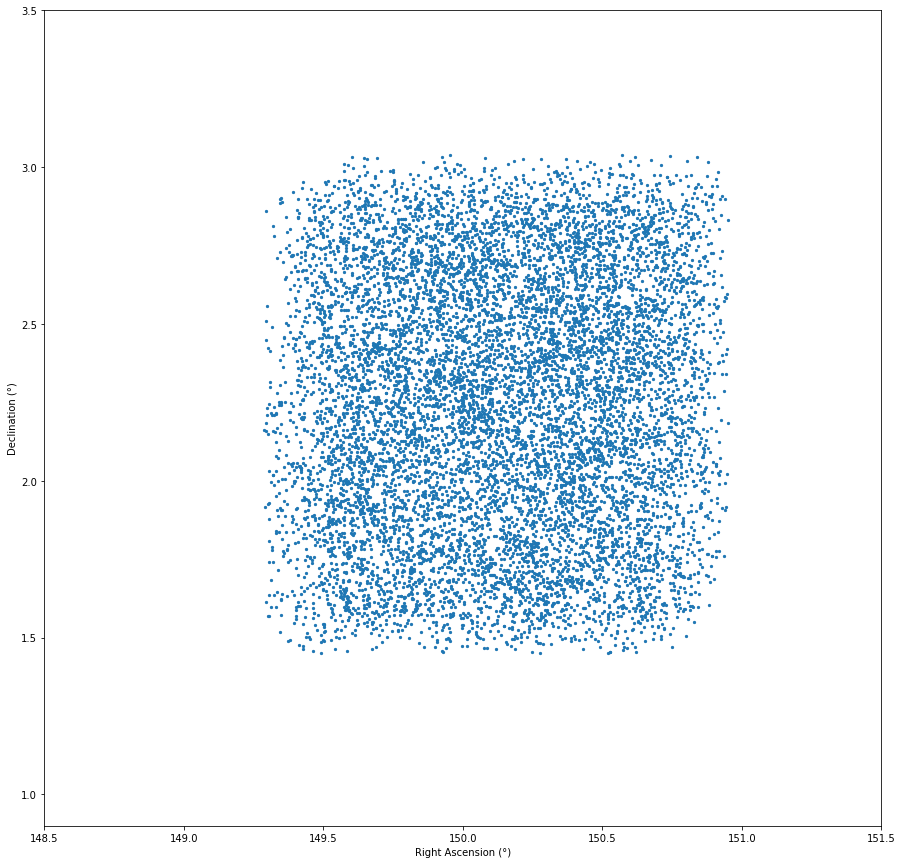

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(vla_data['RA'],vla_data['DEC'],s=5)
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
plt.xlim(148.5,151.5)
plt.ylim(0.9,3.5)

####Herschel

(0.9, 3.5)

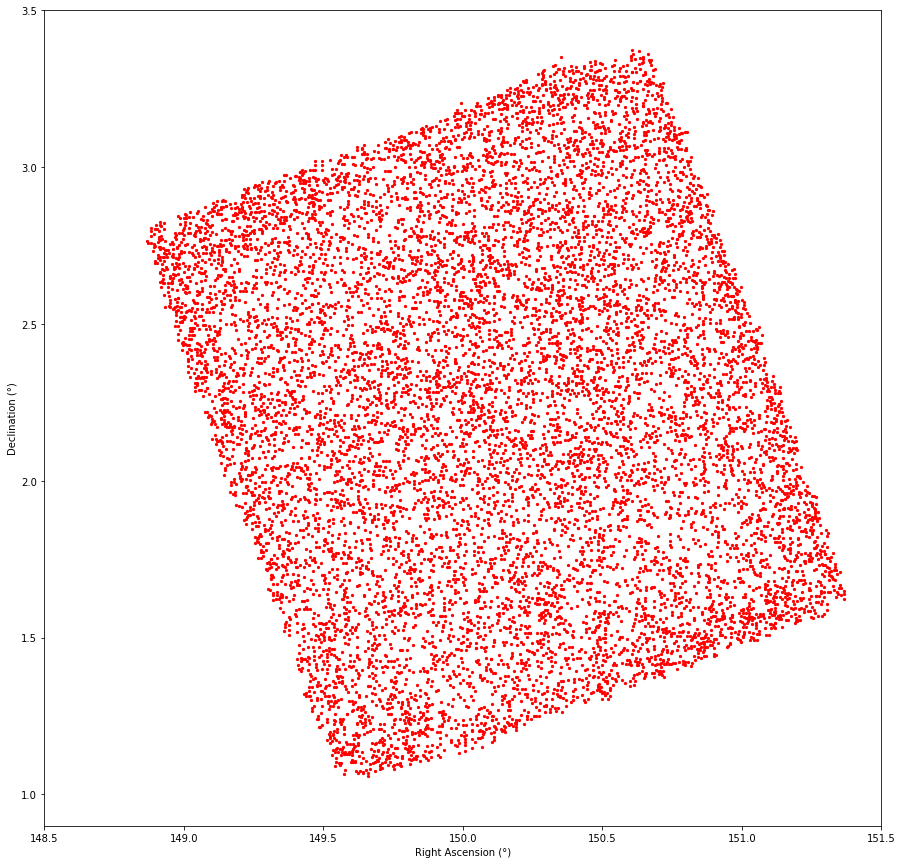

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(h_cosmos['RA'],h_cosmos['Dec'],s=5,c='r')
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
plt.xlim(148.5,151.5)
plt.ylim(0.9,3.5)

(0.9, 3.5)

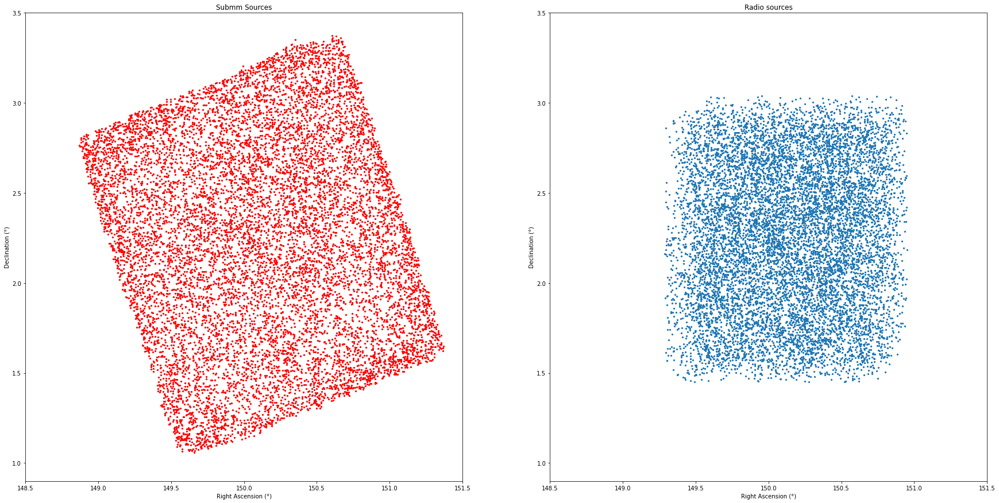

In [ ]:
plt.figure(figsize=(30,15))
plt.subplot(1,2,1)
plt.scatter(h_cosmos['RA'],h_cosmos['Dec'],s=5,c='r')
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
plt.title('Submm Sources')
plt.xlim(148.5,151.5)
plt.ylim(0.9,3.5)
plt.subplot(1,2,2)
plt.scatter(vla_data['RA'],vla_data['DEC'],s=5)
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
plt.title('Radio sources')
plt.xlim(148.5,151.5)
plt.ylim(0.9,3.5)

####Herschel & VLA

Text(0, 0.5, 'Declination (°)')

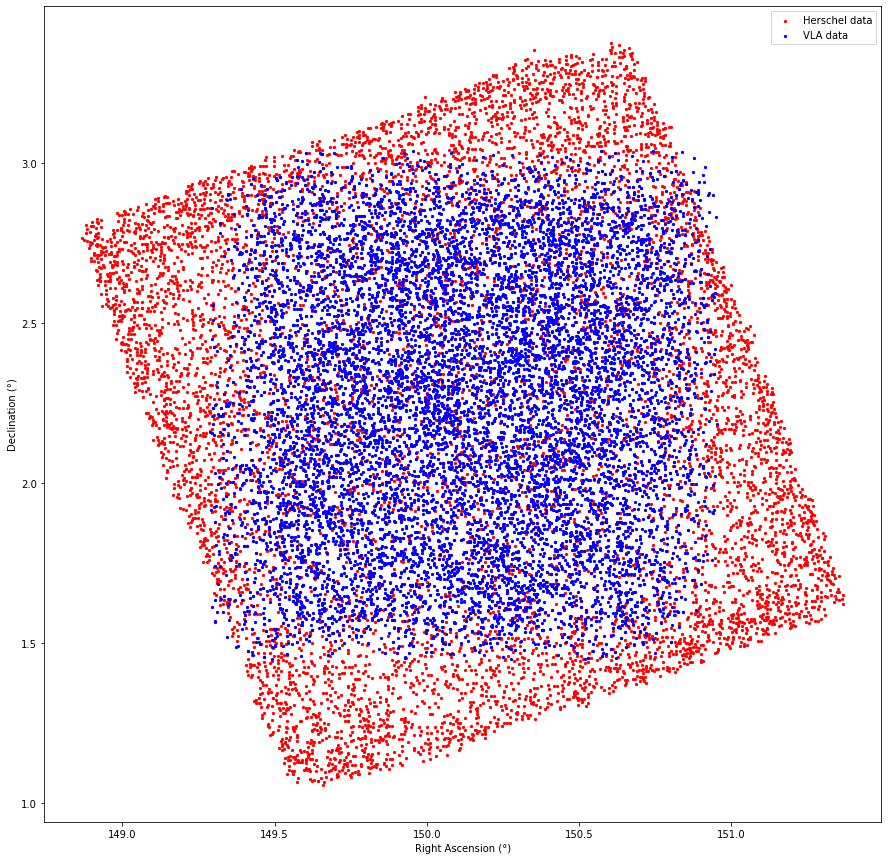

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(h_cosmos['RA'],h_cosmos['Dec'],s=5,c='r')
plt.scatter(vla_data['RA'],vla_data['DEC'],s=5,c='b')
plt.legend(['Herschel data','VLA data'])
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')

####Common area of Herschel and VLA

RA - 149.26 - 150.986
Dec- 1.42   - 3.07


Text(0, 0.5, 'Declination (°)')

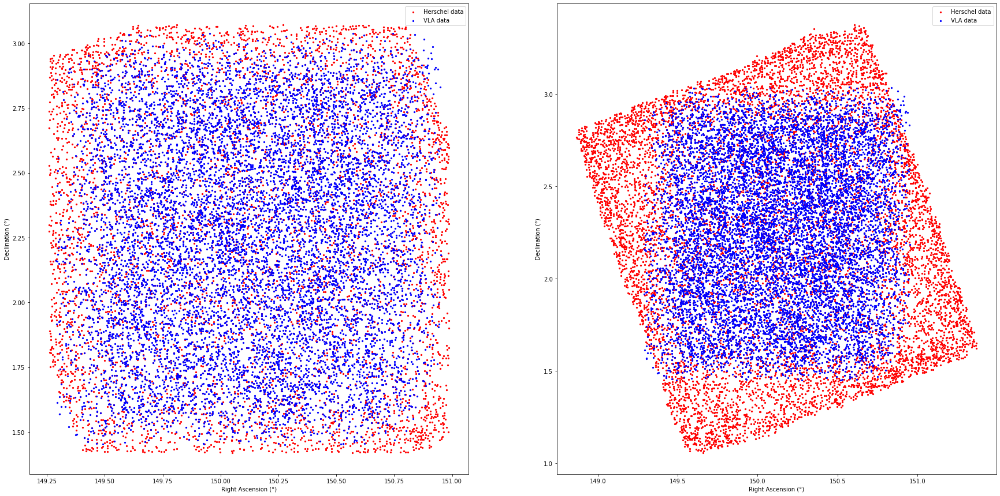

In [ ]:
plt.figure(figsize=(30,15))
plt.subplot(1,2,1)
plt.scatter(h_subset['RA'],h_subset['Dec'],s=5,c='r')
plt.scatter(vla_data['RA'],vla_data['DEC'],s=5,c='b')
plt.legend(['Herschel data','VLA data'])
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
print('RA -',round(min(h_subset['RA']),3),'-',round(max(h_subset['RA']),3))
print('Dec-',round(min(h_subset['Dec']),3),'  -',round(max(h_subset['Dec']),3))
plt.subplot(1,2,2)
plt.scatter(h_cosmos['RA'],h_cosmos['Dec'],s=5,c='r')
plt.scatter(vla_data['RA'],vla_data['DEC'],s=5,c='b')
plt.legend(['Herschel data','VLA data'])
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')

###Fluxes

####Herschel Fluxes

Text(0.5, 1.0, 'F_BLIND_MF_SPIRE_500')

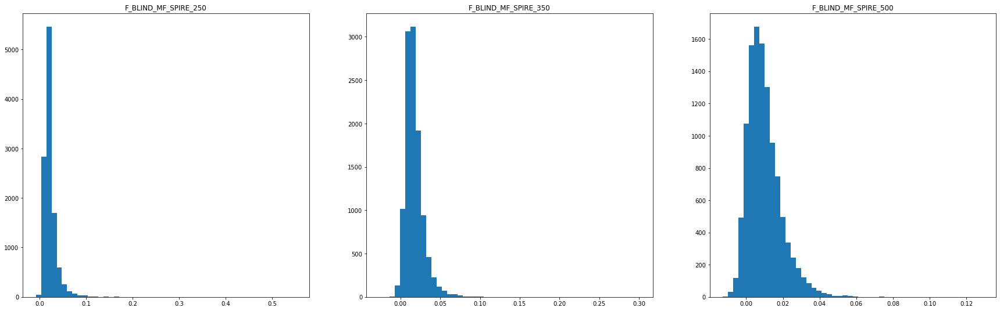

In [ ]:
herschel_data.head()
f = plt.figure(figsize=(30,9))
#plt.figure(figsize=(10,10))
ax=f.add_subplot(131)
ax.hist(herschel_data['F_BLIND_MF_SPIRE_250'],bins=50)
plt.title('F_BLIND_MF_SPIRE_250')
ax2=f.add_subplot(132)
#plt.figure(figsize=(10,10))
ax2.hist(herschel_data['F_BLIND_MF_SPIRE_350'],bins=50)
plt.title('F_BLIND_MF_SPIRE_350')
#plt.figure(figsize=(10,10))
ax3=f.add_subplot(133)
ax3.hist(herschel_data['F_BLIND_MF_SPIRE_500'],bins=50)
plt.title('F_BLIND_MF_SPIRE_500')

In [ ]:
vla_data.head()

,ID,Project,Time,RA,RA_ERR,DEC,DEC_ERR,flux,flux_err,RMS,SNR,NPIX,RES,Multi
0,78,COSMOSVLA3,J095709.33+020940.7,149.288886,0.010,2.161331,0.010,13400.0,670.0,28.7,385.00,104,1,0
1,1110,COSMOSVLA3,J095709.83+015457.4,149.290996,0.021,1.915946,0.021,1190.0,64.0,22.1,29.00,102,1,0
2,5144,COSMOSVLA3,J095710.49+013644.7,149.293720,0.065,1.612418,0.065,145.0,19.0,17.4,8.32,20,0,0
3,3749,COSMOSVLA3,J095710.53+025132.2,149.293890,0.053,2.858966,0.053,345.0,32.0,26.8,10.40,31,1,0
4,10099,COSMOSVLA3,J095710.57+022657.0,149.294072,0.100,2.449174,0.100,92.0,18.0,17.4,5.30,11,0,0


####VLA Fluxes

(0.0, 1000.0)

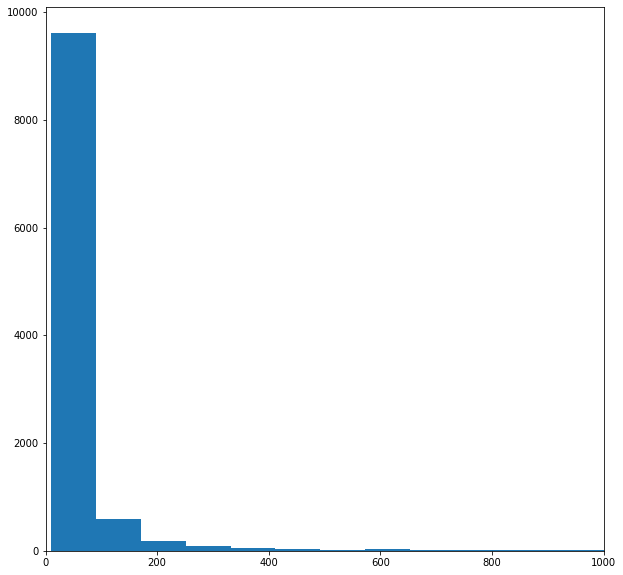

In [ ]:
plt.figure(figsize=(10,10))
plt.hist(vla_data['flux'],bins=1000)
plt.xlim(0,1000)

###Optical

In [ ]:
dat = Table.read('photoz_cosmos2020_lephare_classic_v1.out(1).fits', format='fits') 
#read in the optical dataset
optical_data = dat.to_pandas() #convert table to dataframe
display(optical_data.head())
print(len(optical_data[optical_data['type']==1]))
print(len(optical_data[optical_data['type']==1])/len(optical_data))

,Id,alpha,delta,zBEST,type,zPDF,zPDF_l68,zPDF_u68,zMinChi2,chi2_best,zp_2,chi2_2,NbFilt,zq,chiq,modq,mods,chis,maskUVISTA,maskHSC,maskSCAM,mask,model,age,extinction,MFUV,MNUV,MU,MG,MR,MI,MZ,MY,MJ,MH,MK,mass_med,mass_med_min68,mass_med_max68,mass_best,SFR_med,SFR_med_min68,SFR_med_max68,SFR_best,sSFR_med,sSFR_med_min68,sSFR_med_max68,sSFR_best,L_nu,L_r,L_k
0,1.0,151.008530,1.39828,-99.0,1.0,0.1342,0.1250,0.1429,0.13438,6.165260,-99.900002,2.000000e+08,8.0,0.00,1.591872,10002.0,-393.0,37.624001,1.0,0.0,1.0,1.0,1.0,1.100000e+10,0.0,-15.83110,-16.443140,-20.065941,-21.858330,-22.565109,-23.097481,-23.337879,-23.589661,-23.696131,-23.925930,-23.69519,11.29994,11.26594,11.33398,11.40203,-12.79953,-12.86785,-12.73122,-inf,-24.099529,-24.16785,-24.031219,-inf,7.899,10.008,9.621
1,2.0,151.028824,1.40435,-99.0,1.0,-999.0000,-999.0000,-999.0000,0.00000,1412.494019,-99.900002,2.000000e+08,8.0,7.06,1368.115967,10030.0,-239.0,1159.635010,1.0,1.0,1.0,1.0,-999.0,-9.990000e+02,-999.0,-999.00000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.000000,-999.00000,-999.00000,-999.00000,-999.00000,-999.00000,-999.00000,-999.00000,-999.00000,-999.0000,-999.000000,-999.00000,-999.000000,-999.000,-999.000,-999.000,-999.000
2,3.0,151.007706,1.39844,-99.0,1.0,0.4195,0.4123,0.4266,0.42285,11.064650,-99.900002,5.000000e+08,5.0,0.00,21.321301,10001.0,-390.0,8.600266,1.0,0.0,1.0,1.0,5.0,5.088000e+08,0.1,-21.16188,-21.320669,-21.646891,-21.996099,-22.271080,-22.174040,-22.249950,-22.280790,-22.238590,-22.276461,-21.53830,9.85310,9.78263,9.92495,9.89196,1.27791,1.17973,1.37015,1.3240,-8.578110,-8.70807,-8.444110,-8.568,10.221,9.934,8.954
3,4.0,150.162369,1.39162,-99.0,0.0,1.8571,1.6985,2.0518,1.84870,1.522740,-99.900002,1.666667e+08,9.0,1.46,2.205567,10029.0,-11.0,6.719943,1.0,0.0,1.0,1.0,5.0,3.000000e+09,0.0,-18.00897,-17.736500,-18.340191,-18.955500,-19.180519,-19.237789,-19.344049,-19.402500,-19.402290,-19.493490,-19.22595,8.83417,8.61096,8.98793,9.04545,-0.25697,-0.35963,0.08057,-0.3379,-9.060990,-9.30333,-8.618760,-9.383,8.582,8.618,7.823
4,5.0,149.540176,1.39154,-99.0,0.0,1.3280,1.0682,1.7022,1.31430,1.634610,0.830000,1.680232e+00,8.0,0.32,2.147980,10028.0,-1.0,1.515800,1.0,0.0,1.0,1.0,10.0,5.000000e+07,0.0,-17.38682,-16.613689,-17.890280,-16.774210,-16.775999,-16.319000,-16.293770,-16.257589,-16.166969,-16.093969,-15.73476,7.87928,7.44103,8.38222,6.92816,-0.56944,-0.69267,-0.28308,-0.4127,-8.394300,-8.96353,-7.899050,-7.341,8.242,7.562,6.428


62465
0.03630208636020224


In [ ]:
for t in optical_data['type'].unique():
  print(t)
  print(len(optical_data[optical_data['type']==t]))
  print((len(optical_data[optical_data['type']==t])/len(optical_data))*100 )

1.0
62465
3.630208636020224
0.0
1652714
96.04893357354565
-9.0
1974
0.1147207531818446
2.0
3547
0.20613703725228105


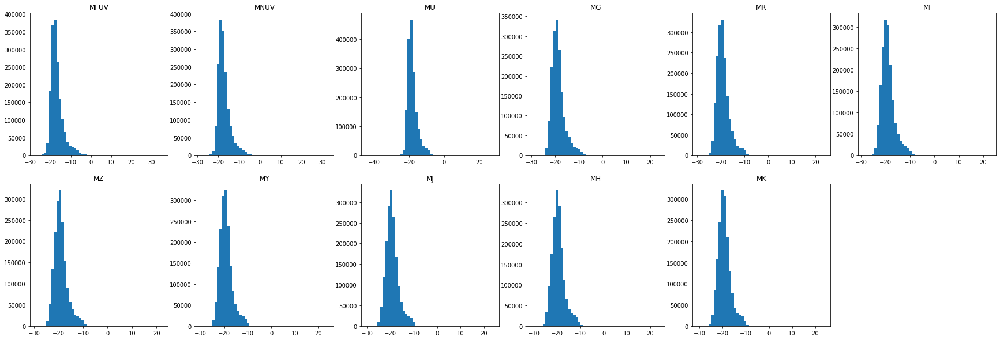

In [ ]:
bands=['MFUV',	'MNUV',	'MU',	'MG',	'MR',	'MI',	'MZ',	'MY',	'MJ',	'MH',	'MK'	]
i=1
plt.figure(figsize=(30,10))
for band in bands:
  plt.subplot(2,6,i)
  optical_data2=optical_data[optical_data[band]>-100]
  optical_data2=optical_data2[optical_data2[band]<100]

  plt.hist(optical_data2[band],bins=50)
  plt.title(band)
  i+=1

Text(0, 0.5, 'Declination (°)')

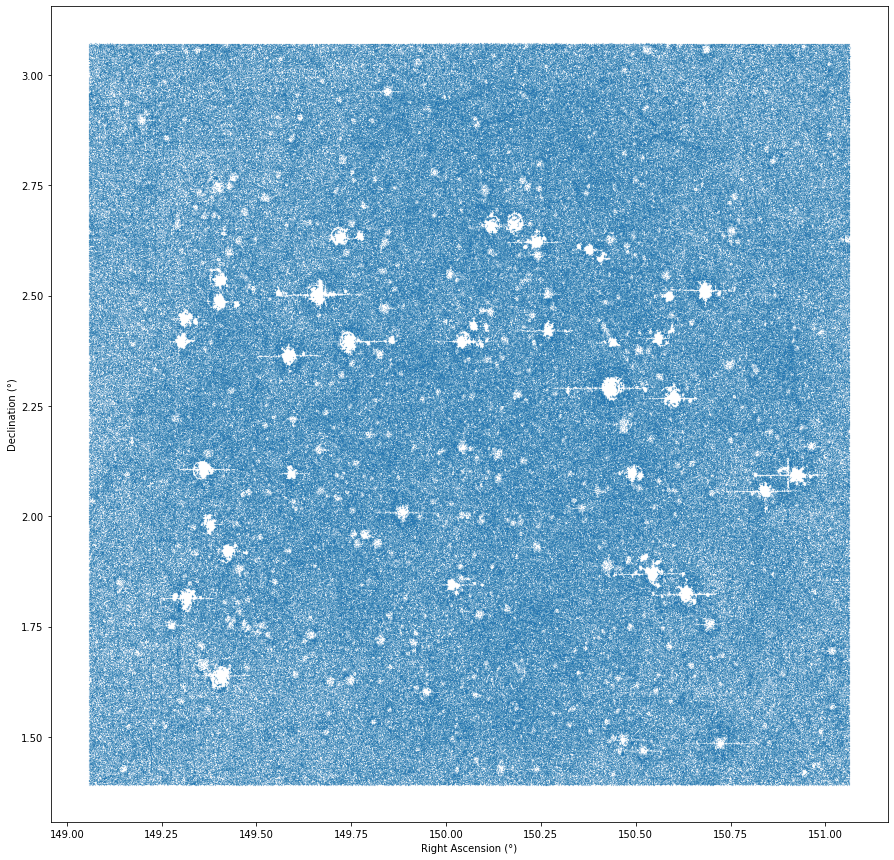

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(optical_data['alpha'],optical_data['delta'],s=0.01)
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')


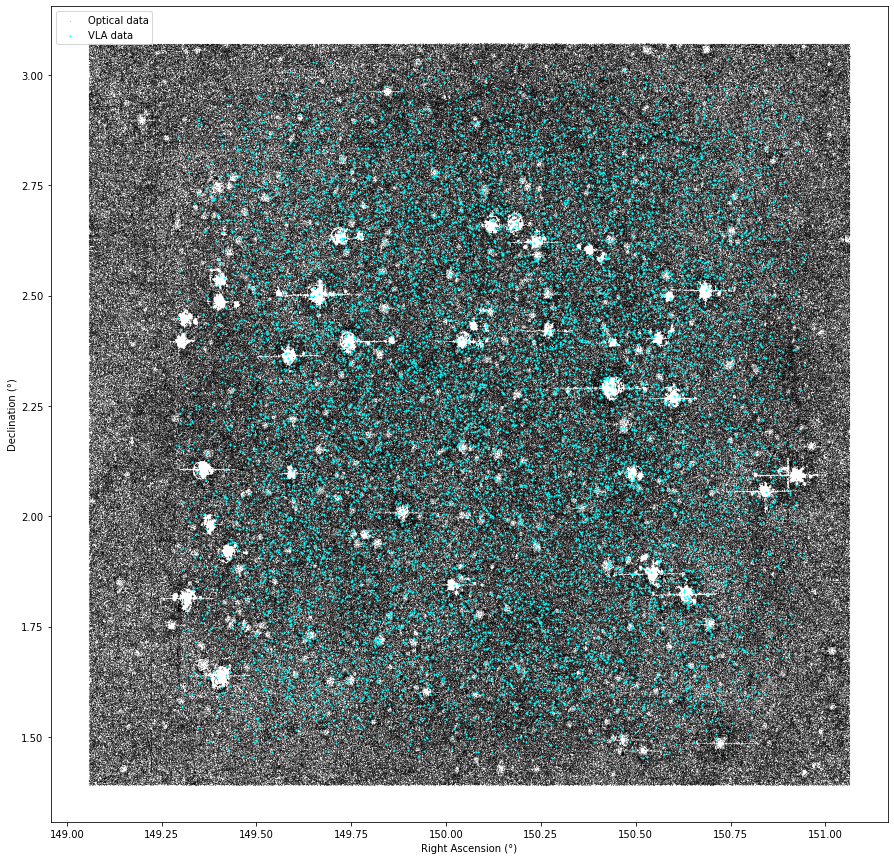

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(optical_data['alpha'],optical_data['delta'],s=0.01,c='black')
plt.xlabel('Right Ascension (°)')
plt.ylabel('Declination (°)')
plt.scatter(vla_data['RA'],vla_data['DEC'],s=1,c='aqua')
plt.legend(['Optical data','VLA data'],loc=2)

1649151


(array([1.00000e+00, 1.00000e+00, 3.00000e+00, 3.00000e+00, 4.00000e+00,
        6.00000e+00, 1.00000e+01, 7.00000e+00, 1.20000e+01, 9.00000e+00,
        2.70000e+01, 4.00000e+01, 4.20000e+01, 2.20000e+01, 2.10000e+01,
        3.60000e+01, 1.37000e+02, 1.34000e+02, 5.90000e+01, 1.00000e+01,
        1.90000e+01, 3.00000e+01, 8.50000e+01, 5.00000e+01, 3.90000e+01,
        1.60000e+01, 3.00000e+01, 4.60000e+01, 7.70000e+01, 4.70000e+01,
        2.50000e+01, 4.40000e+01, 1.43000e+02, 1.39000e+02, 8.20000e+01,
        3.70000e+01, 5.90000e+01, 9.10000e+01, 1.65000e+02, 1.76000e+02,
        7.40000e+01, 3.30000e+01, 3.40000e+01, 7.20000e+01, 8.00000e+01,
        8.20000e+01, 1.05000e+02, 1.36000e+02, 2.15000e+02, 3.44000e+02,
        1.50000e+02, 4.40000e+01, 2.00000e+01, 2.80000e+01, 5.50000e+01,
        6.50000e+01, 6.90000e+01, 8.90000e+01, 2.57000e+02, 6.64000e+02,
        1.08000e+03, 5.73000e+02, 2.22000e+02, 2.79000e+02, 5.47000e+02,
        5.89000e+02, 3.96000e+02, 3.99000e+02, 5.81

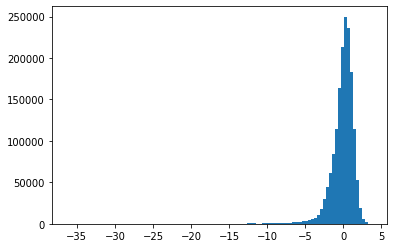

In [ ]:
t=optical_data[optical_data['SFR_best']>-90]
t=t[t['type']==0]
t=t.dropna()
print(len(t))
t1=t.sample(5000)
plt.hist(t['SFR_best'],bins=100)

####Redshift

(0.0, 10.0)

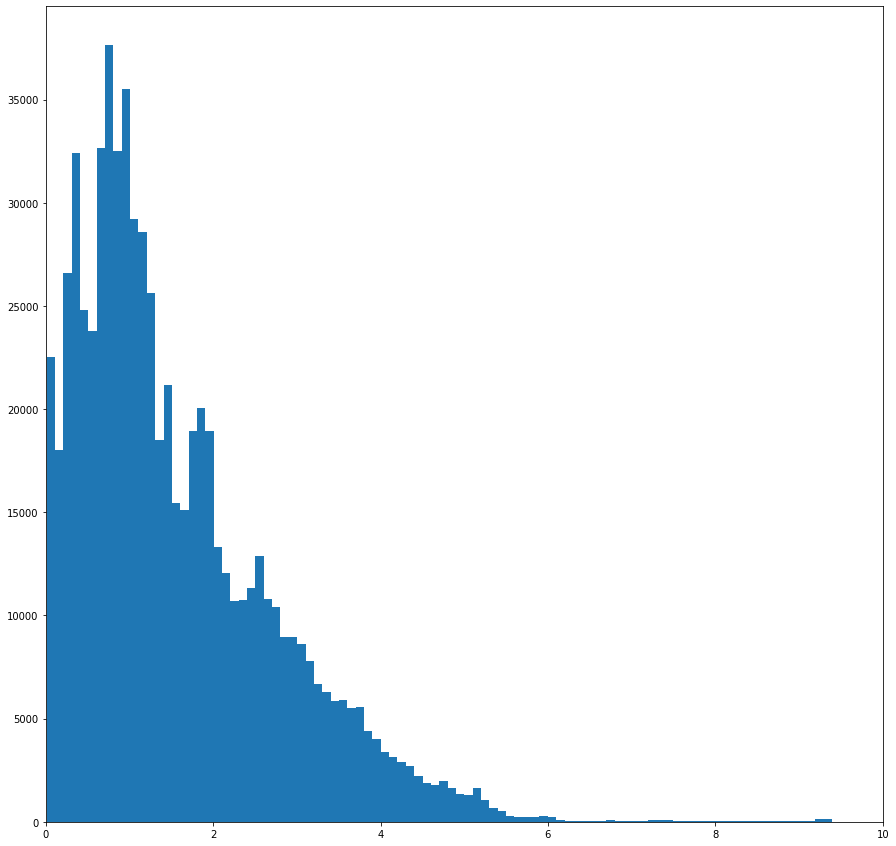

In [ ]:
optical_data2=optical_data[optical_data['zBEST']>-99]
optical_data2=optical_data2[optical_data2['zBEST']<99]
optical_data2=optical_data2[optical_data2['type']==0]
plt.figure(figsize=(15,15))
plt.hist(optical_data2['zBEST'],bins=100)
plt.xlim(0,10)

####Mass

(array([1.00000e+00, 1.00000e+00, 1.20000e+01, 2.30000e+01, 5.40000e+01,
        1.28000e+02, 3.99000e+02, 7.25000e+02, 1.50500e+03, 2.39300e+03,
        3.46700e+03, 4.76600e+03, 6.25800e+03, 7.55000e+03, 8.67700e+03,
        9.82600e+03, 1.05020e+04, 1.14680e+04, 1.27710e+04, 1.39840e+04,
        1.52890e+04, 1.75580e+04, 2.09090e+04, 2.71270e+04, 3.59850e+04,
        4.84940e+04, 6.28140e+04, 7.81120e+04, 9.21590e+04, 1.04233e+05,
        1.12713e+05, 1.20490e+05, 1.26585e+05, 1.25887e+05, 1.16335e+05,
        1.03529e+05, 8.75420e+04, 7.06230e+04, 5.74080e+04, 4.54130e+04,
        3.68820e+04, 3.04800e+04, 2.51620e+04, 1.98480e+04, 1.35500e+04,
        8.09200e+03, 3.93400e+03, 1.65000e+03, 5.10000e+02, 1.89000e+02,
        8.20000e+01, 4.50000e+01, 6.00000e+00, 3.00000e+00, 1.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00

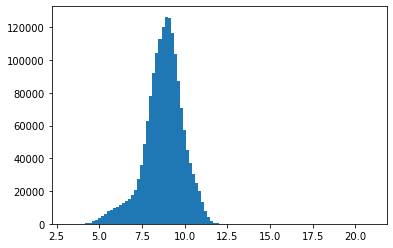

In [ ]:
t=optical_data[optical_data['mass_best']>0]['mass_best'].dropna()
plt.hist(t,bins=100)

(array([339027., 138215., 163530., 156002., 101422.,  51269., 103113.,
         53288.,  63044.,  49131.,      0.,  34793.,  42115.,  44213.,
             0.,  45834.,      0.,  45714.,      0.,      0.,  48099.,
             0.,      0.,  51031.,      0.,      0.,  41261.,      0.,
             0.,      0.,  28543.,      0.,      0.,      0.,  20281.,
             0.,      0.,      0.,  17508.,      0.,      0.,      0.,
         14308.,      0.,      0.,      0.,  13169.,      0.,      0.,
             0.,  11203.,      0.,      0.,   8632.,      0.,      0.,
             0.,   6909.,      0.,      0.,      0.,   7155.,      0.,
             0.,      0.,      0.,      0.,      0.,      0.,   6807.,
             0.,      0.,      0.,      0.,      0.,      0.,   3922.,
             0.,      0.,      0.,      0.,      0.,      0.,      0.,
          5004.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,   4911.,      0.,      0.,      0.,      0.,      0.,
      

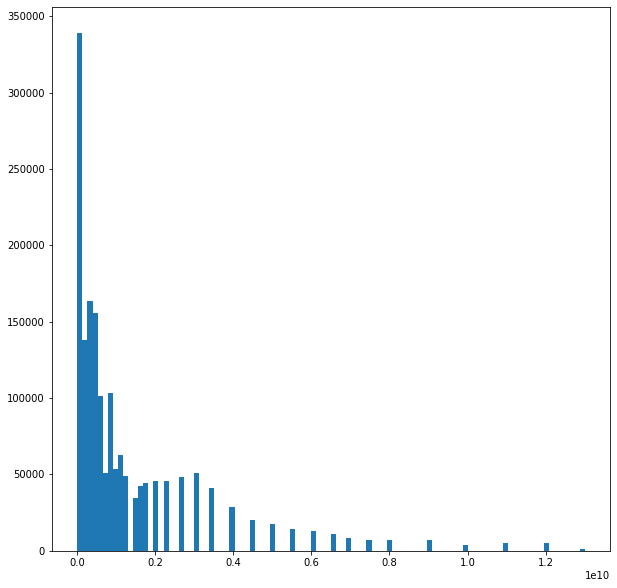

In [ ]:
plt.figure(figsize=(10,10))
plt.hist(optical_data['age'],bins=100)

#Counterparts

Number of radio counterparts at 1 arcsec- 442
Number of radio counterparts at 2 arcsec- 1481
Number of radio counterparts at 3 arcsec- 2390
Number of radio counterparts at 4 arcsec- 3023
Number of radio counterparts at 5 arcsec- 3459
Number of radio counterparts at 6 arcsec- 3787
Number of radio counterparts at 7 arcsec- 4040
Number of radio counterparts at 8 arcsec- 4263
Number of radio counterparts at 9 arcsec- 4445
Number of radio counterparts at 10 arcsec- 4613
2.8947727300386443


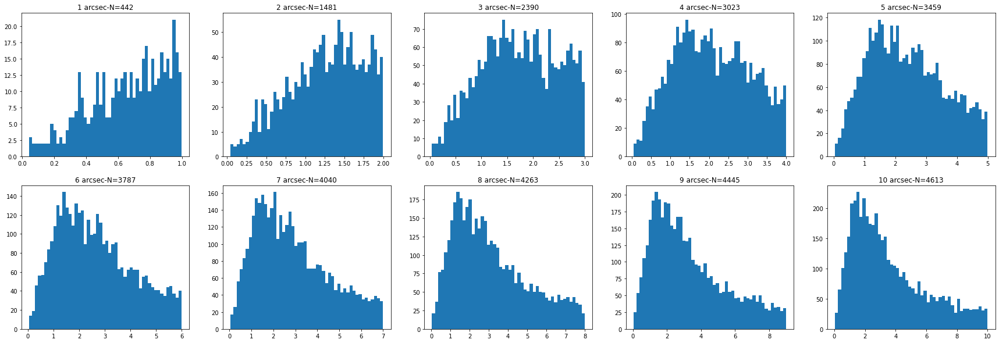

In [ ]:
plt.figure(figsize=(30,10))
num=[]
for i in range(1,11):
  
  dat3 = Table.read(f'matches_{i}_arcsec.fits', format='fits') #read in matched data
  match_df = dat3.to_pandas() #convert table to dataframe

  plt.subplot(2,5,i)
  plt.hist(match_df['Separation'],bins=50)
  plt.title(f'{i} arcsec-N={len(match_df)}')
  num.append(match_df['Separation'].median())
  print(f'Number of radio counterparts at {i} arcsec-',len(match_df))
print(match_df['Separation'].median())


##Radio Counterparts

In [ ]:
#Herschel Data Matched with VLA Data with a max radius of 10 arseconds

dat3 = Table.read(f'Random_matches/matches.fits', format='fits') #read in matched data
m = dat3.to_pandas() #convert table to dataframe
m.rename(columns={"col1": "ID_match","col2": "Project_match", #rename columns
                        "col3": "Time_match","col4": "RA_match",
                        "col5": "RA_ERR_match","col6": "DEC_match",
                        "col7": "DEC_ERR_match","col8": "flux_match",
                        "col9": "flux_err_match","col10": "RMS_match",
                        "col11": "SNR_match","col12": "NPIX_match",
                        "col13": "RES_match","col14": "Multi_match",
                        },inplace=True)

#Concatinate vla_data and matched sources for faster calculations
vla_1 = vla_data[['flux']]
match = pd.concat([ vla_1,m ],axis=1) #concatinate vla_data and matched data for dataframe vectorisation
match.head(2)

,flux,RA,Dec,F_BLIND_MF_SPIRE_250,FErr_BLIND_MF_SPIRE_250,F_BLIND_MF_SPIRE_350,FErr_BLIND_MF_SPIRE_350,F_BLIND_MF_SPIRE_500,FErr_BLIND_MF_SPIRE_500,r,P,RA_pix,Dec_pix,F_BLIND_pix_SPIRE_250,FErr_BLIND_pix_SPIRE_250,ID_match,Project_match,Time_match,RA_match,RA_ERR_match,DEC_match,DEC_ERR_match,flux_match,flux_err_match,RMS_match,SNR_match,NPIX_match,RES_match,Multi_match,Separation
0,13400.0,150.745831,2.343037,0.359749,0.002514,0.170467,0.002517,0.071225,0.002517,0.815560,1.0,150.745553,2.343315,0.334421,0.002447,14.0,b'COSMOSVLA3',b'J100259.05+022034.9',150.746079,0.010,2.343043,0.010,5940.0,300.0,4.3,1300.0,108.0,1.0,0.0,0.893035
1,1190.0,149.773592,2.636177,0.230962,0.002527,0.108277,0.002489,0.040625,0.002555,0.842207,1.0,149.773036,2.636732,0.204455,0.002459,10944.0,b'COSMOSVLA3',b'J095905.52+023809.8',149.773020,9.999,2.636075,9.999,948.0,-99.0,2.5,-99.0,1327.0,1.0,1.0,2.089115


####Number of radio counterparts

In [ ]:
print('Number of radio counterparts at 10arcsec-',len(match_df))
print('Percentage of Herschel sources with radio counterparts-',round((len(match_df)/len(h_subset))*100,4),'%')

Number of radio counterparts at 10arcsec- 4613
Percentage of Herschel sources with radio counterparts- 59.5533 %


####Functions for counterparts

In [ ]:
#Max flux_match value 46200.0  Max Radio value 80300.0
#vectorisation #matched10 1379 values
def stat(vla, match, distance): #function to calculate s stat
  area=6228*5940 #measured dRA and dDEC
  num_flux= ( vla.to_numpy() > match.to_numpy()[:,None]).sum(axis=1) #number of VLA sources with flux greater than matched flux
  #print(num_flux)
  surface_density= num_flux/area #density: number of high flux stars per area
  s= 1-np.exp(-1*np.pi*distance**2*surface_density) #S statistic caluation 0 indicates a very good counterpart and 1 indicates a poor counterpart
  return s

#Normalise S statistic
def norm(df):
  df=(df - df.min()) / (df.max() - df.min()) #normalisation calculation over dataframe column
  return df

#Optimise S statistic cut-off at 5%
def optimise_s(real,rand):  #function to find S threshold so that there is a 95% purity
  ratio_s=1
  filter=0.25 #initial threshold
  while ratio_s>0.05: #loop till purity is above 95%
    filter-=0.001 #stepsize
    number_s=[]
    for idx,source in real.iterrows(): #iterate through matched sources
      if source['s_norm']>filter: #go back to while if s value is greater than threshold
        continue
      #finds the number of random sources with s less than the s value of our source.
      num_rand = rand['s_r_norm'][ rand['s_r_norm'] < source['s_norm'] ].count() #number of random sources with better S value than the real sources
      number_s.append(num_rand)
    avg_s = np.mean(number_s) #find avg number of random sources with better S value than real source
    ratio_s = avg_s/rand['s_r_norm'].count() #find proportion of random sources with S values better than real sources, we want this to be under 0.05
    print(f's-limit: {round(filter,5)}, result:{round(ratio_s,5)}')
  prop = avg_s/ real['s_norm'].count()
  print(f'Final s-limit is: {round(filter,5)}, with result:{round(ratio_s,5)}, this removes {round(prop,5 )} of the data \n\n')
  print(f'threshold value of s-{round(filter,5)}')
  return filter

  #Optimise S statistic cut-off at 5%
def acc_optimise_s(real,rand,filter,stepsize):  #optimising function that allows to change stepsize and initial threshold value for more accurate calculations
  ratio_s=1
  while ratio_s>0.05: #loop till purity is above 95%
    filter-=stepsize
    number_s=[]
    for idx,source in real.iterrows(): #iterate through matched sources
      if source['s_norm']>filter: #go back to while if s value is greater than threshold
        continue
      #finds the number of random sources with s less than the s value of our source.
      num_rand = rand['s_r_norm'][ rand['s_r_norm'] < source['s_norm'] ].count()
      number_s.append(num_rand)
    avg_s = np.mean(number_s) #find avg number of random sources with better S value than real source
    ratio_s = avg_s/rand['s_r_norm'].count() #find proportion of random sources with S values better than real sources, we want this to be under 0.05
    print(f's-limit: {round(filter,5)}, result:{round(ratio_s,5)}')
  prop = avg_s/ real['s_norm'].count()
  print(f'Final s-limit is: {round(filter,5)}, with result:{round(ratio_s,5)}, this removes {round(prop,5 )} of the data \n\n')
  print(f'threshold value of s-{round(filter,5)}')

(0.0, 600.0)

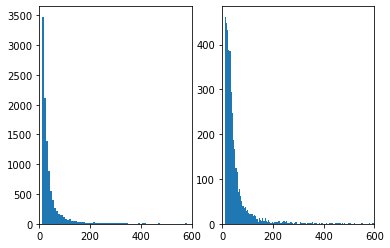

In [ ]:
plt.subplot(1,2,1)
plt.hist(match['flux'],bins=10000)
plt.xlim(0,600)
plt.subplot(1,2,2)
plt.hist(match['flux_match'],bins=10000)
plt.xlim(0,600)

####Separation of matches

At 1"- percentage of matches that are expected false 2.33%
At 2"- percentage of matches that are expected false 2.78%
At 3"- percentage of matches that are expected false 3.87%
At 4"- percentage of matches that are expected false 5.44%
At 5"- percentage of matches that are expected false 7.43%
At 6"- percentage of matches that are expected false 9.78%
At 7"- percentage of matches that are expected false 12.48%
At 8"- percentage of matches that are expected false 15.44%
At 9"- percentage of matches that are expected false 18.75%
At 10"- percentage of matches that are expected false 22.3%


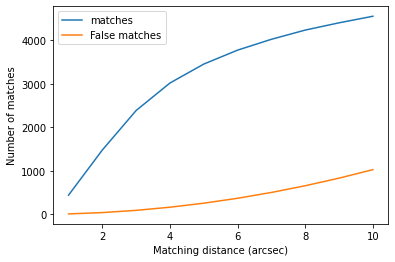

In [ ]:
area=6228*5940
n=len(vla_data)/area


import matplotlib.pyplot as plt


match_dist={}
matches=[]
dist=[]
false_matches=[]

#uses a for loop to create a dictionary containing all the dataframes of matches for a given search radius
#The number used for the key indicateds the match radius
#files have been created using match in TOPCAT within the search area and named matches_i_arcsec.fits i is an integer between 1-10 inclusive
for i in range(1,11):
  dat = Table.read(f'matches_{i}_arcsec.fits', format='fits') 
  #read in the table uses the link from the internet so dont need to connect to drive every time
  match = dat.to_pandas() #convert table to dataframe
  #rename columns from vla data to be understandable
  match.rename(columns={"col1": "ID", 
                           "col2": "Project",
                           "col3": "Time", 
                           "col4": "RA_rad",
                           "col5": "RA_ERR", 
                           "col6": "DEC_rad",
                           "col7": "DEC_ERR", 
                           "col8": "flux",
                           "col9": "flux_err", 
                           "col10": "RMS",
                           "col11": "SNR", 
                           "col12": "NPIX", 
                           "col13": "RES", 
                           "col14": "Multi",
                           },inplace=True)
  #gets the number of matches per radius
  matches.append(match['ID'].nunique())
  match_dist[i]=match
  dist.append(i) #appends the search distance
  false_matches.append(np.pi*i**2*n*len(herschel_data)) #calculates number of expected false matches per radius
  print(f'At {i}"- percentage of matches that are expected false {round(100*(false_matches[i-1])/len(match),2)}%')
  #print(match.head().to_markdown())
  #matches_10.df = matches_10.dropna(subset=['col1'])
#print(matches)
#print([round(i,2) for i in false_matches])



plt.plot(dist,matches,label='matches')
plt.plot(dist,false_matches,label='False matches')
plt.xlabel('Matching distance (arcsec)')
plt.ylabel('Number of matches')
plt.legend()

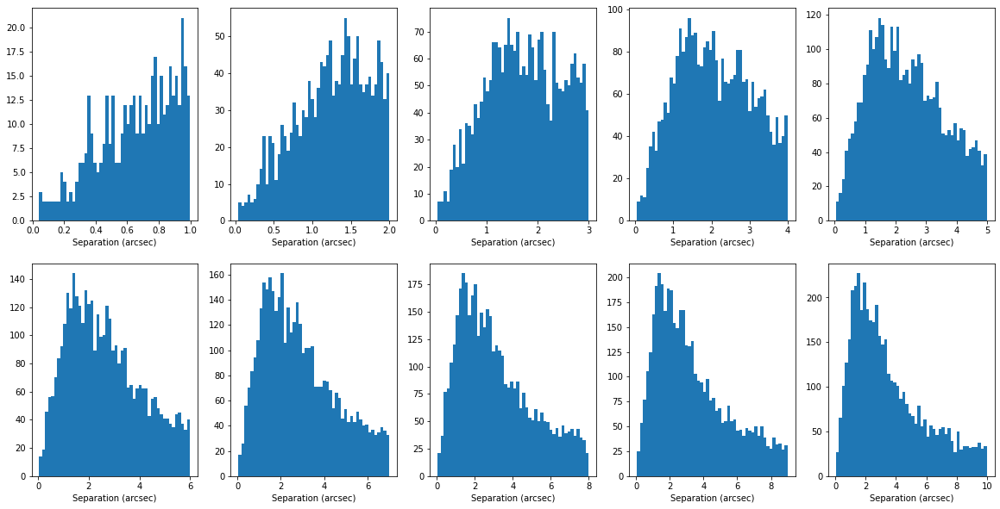

In [ ]:
plt.figure(figsize=(20,10))
for i in (match_dist.keys()):
  plt.subplot(2,len(match_dist.keys())/2,i)
  plt.hist(match_dist[i]['Separation'],bins=50)
  plt.xlabel('Separation (arcsec)')



####Flux of matches

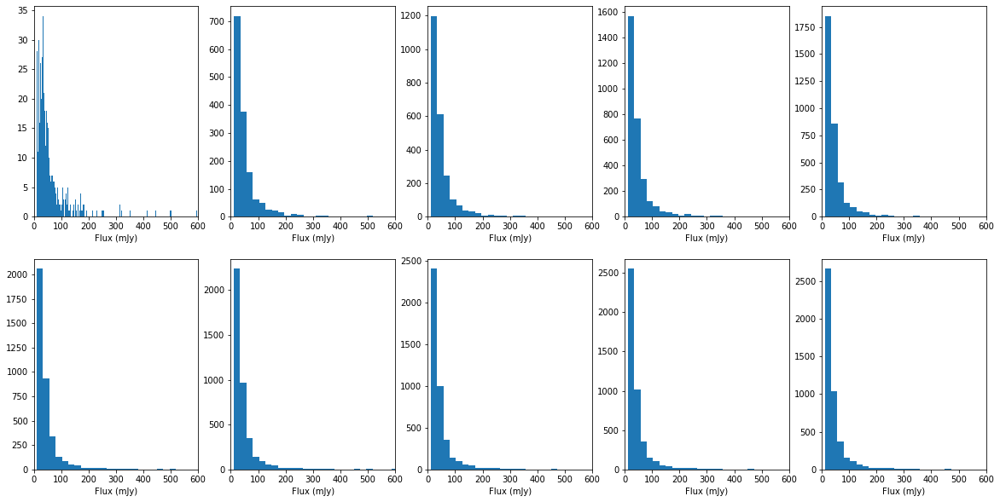

In [ ]:
plt.figure(figsize=(20,10))
for i in (match_dist.keys()):
  plt.subplot(2,len(match_dist.keys())/2,i)
  plt.hist(match_dist[i]['flux'],bins=2000)
  plt.xlim(0,600)
  plt.xlabel('Flux (mJy)')

####Generating random Sources

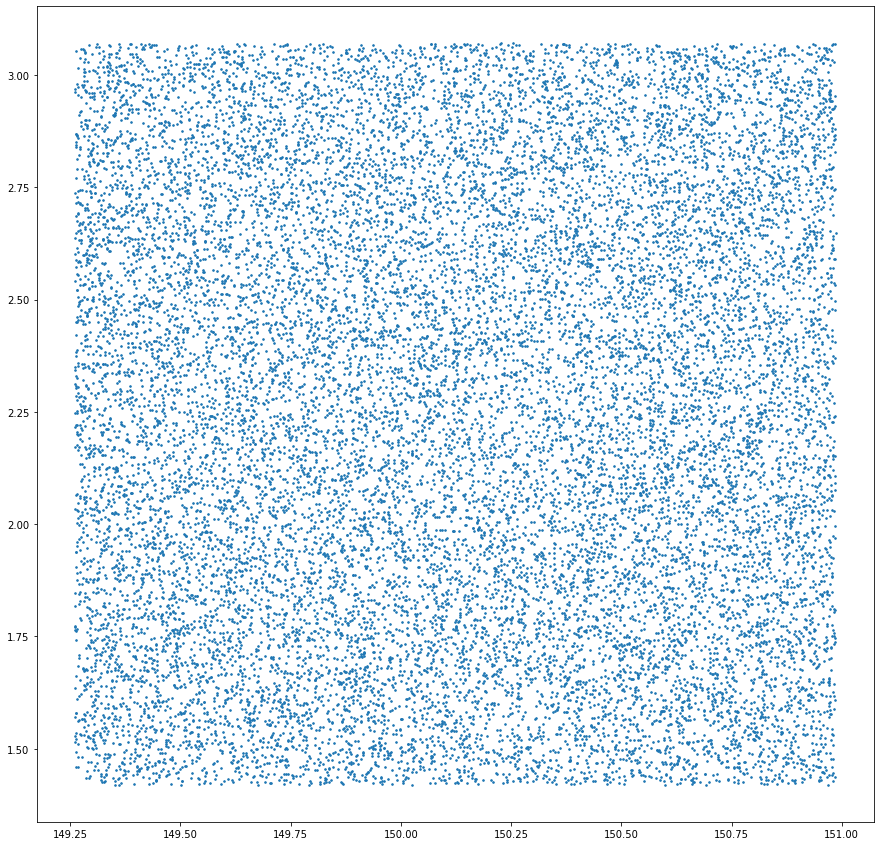

In [ ]:
sample_size=int(2e4)
df_mc2 = pd.DataFrame({'RA':np.random.uniform(low=149.26,high=150.986,size=sample_size),
                       'Dec':np.random.uniform(low=1.42,high=3.07,size=sample_size),
                       'flux':np.random.choice(vla_data['flux'],size=sample_size)})

plt.figure(figsize=(15,15))
plt.scatter(df_mc2['RA'],df_mc2['Dec'],s=2.5)

####Random Source on Herschel

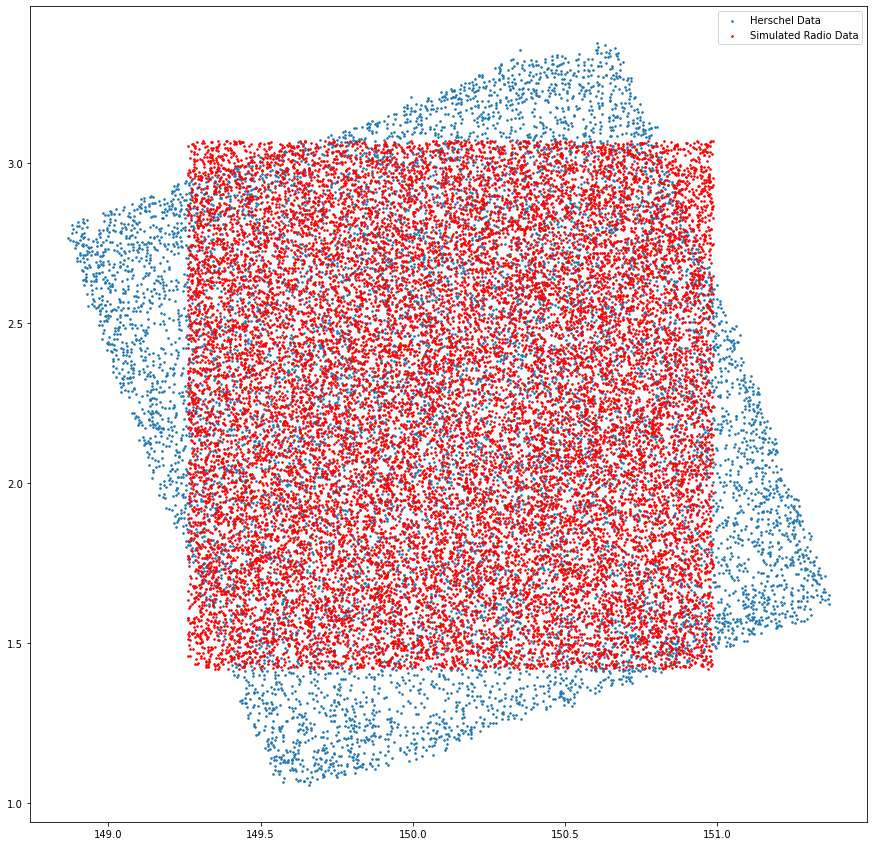

In [ ]:
plt.figure(figsize=(15,15))
plt.scatter(herschel_data['RA'],herschel_data['Dec'],s=2.5)
plt.scatter(df_mc2['RA'],df_mc2['Dec'],s=2.5,c='r')
plt.legend(['Herschel Data','Simulated Radio Data'])

####Finding s statistic of random matches

In [ ]:
#Herschel Data Matched with VLA Data with a max radius of 10 arseconds

dat3 = Table.read(f'Random_matches/matches.fits', format='fits') #read in matched data
m = dat3.to_pandas() #convert table to dataframe
m.rename(columns={"col1": "ID_match","col2": "Project_match", #rename columns
                        "col3": "Time_match","col4": "RA_match",
                        "col5": "RA_ERR_match","col6": "DEC_match",
                        "col7": "DEC_ERR_match","col8": "flux_match",
                        "col9": "flux_err_match","col10": "RMS_match",
                        "col11": "SNR_match","col12": "NPIX_match",
                        "col13": "RES_match","col14": "Multi_match",
                        },inplace=True)

#Concatinate vla_data and matched sources for faster calculations
vla_1 = vla_data[['flux']]
match = pd.concat([ vla_1,m ],axis=1) #concatinate vla_data and matched data for dataframe vectorisation
match.head(2)
#Calucate S statistic for matched sources at 10 arcsec
match['s']= stat(
          match['flux'], 
          match['flux_match'], 
          match['Separation'].values
          )
match['s_norm'] = norm(match['s']) #normalise S statistic for probability distribution
print(match['s_norm'].head(2))

0    0.000034
1    0.000769
Name: s_norm, dtype: float64


In [ ]:
#Concatinate vla_data and matched sources for faster calculations
vla_1 = vla_data[['flux']]

#import Monte Carlo simulation 
dat = Table.read(f'Random_matches/matches.fits', format='fits')
rand_0 = dat.to_pandas() #convert table to dataframe
rand_0.drop('col1',axis=1,inplace=True) #remove null columns
rand_0 = rand_0.rename(columns={"flux": "flux_match",'col8':'flux_match'}) #rename columns 

r1 = rand_0[['flux_match','Separation']] #make into one dataframe for vectorisation
random = pd.concat([ vla_1,r1 ],axis=1) #concatinate to speed up calculations
random.info()
rand_0.head()

random['s_r']= stat(random['flux'],random['flux_match'],random['Separation'].values) #Calculate S statistic for Monte Carlo matches
random['s_r_norm'] = norm( random['s_r']) #Normalise s for Monte Carlo matches 
fig = go.Figure() #plot Random s distribution with Real s distribution
fig.add_trace(go.Histogram(x=match['s'],name='Real',nbinsx=200,opacity=0.5))
fig.add_trace(go.Histogram(x=random['s_r'],name='Random',opacity=0.5,nbinsx=200))
fig.update_layout(barmode='overlay')
fig.show()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10830 entries, 0 to 10829
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   flux        10830 non-null  float64
 1   flux_match  4094 non-null   float32
 2   Separation  4094 non-null   float64
dtypes: float32(1), float64(2)
memory usage: 211.6 KB


###Normalised
Compare the Normalised S statistics for the Real and Random Matches. <br>
We can see after normalisation the s values are closer to what we expect.

(array([1.334e+03, 5.680e+02, 3.620e+02, 2.600e+02, 2.230e+02, 1.500e+02,
        1.120e+02, 1.080e+02, 6.600e+01, 7.300e+01, 7.700e+01, 5.400e+01,
        4.400e+01, 4.900e+01, 4.200e+01, 4.500e+01, 3.900e+01, 3.600e+01,
        2.300e+01, 2.400e+01, 1.800e+01, 1.700e+01, 1.600e+01, 2.200e+01,
        1.700e+01, 2.100e+01, 1.500e+01, 2.400e+01, 1.400e+01, 1.400e+01,
        9.000e+00, 1.200e+01, 1.500e+01, 8.000e+00, 7.000e+00, 1.100e+01,
        5.000e+00, 6.000e+00, 7.000e+00, 6.000e+00, 7.000e+00, 9.000e+00,
        2.000e+00, 7.000e+00, 6.000e+00, 8.000e+00, 8.000e+00, 4.000e+00,
        6.000e+00, 6.000e+00, 3.000e+00, 7.000e+00, 1.000e+00, 2.000e+00,
        2.000e+00, 1.000e+00, 0.000e+00, 5.000e+00, 3.000e+00, 1.000e+00,
        4.000e+00, 3.000e+00, 4.000e+00, 2.000e+00, 4.000e+00, 2.000e+00,
        3.000e+00, 1.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 1.000e+00,
        1.000e+00, 2.000e+00, 1.000e+00, 2.000e+00, 1.000e+00, 1.000e+00,
        3.000e+00, 0.000e+00, 0.000e+0

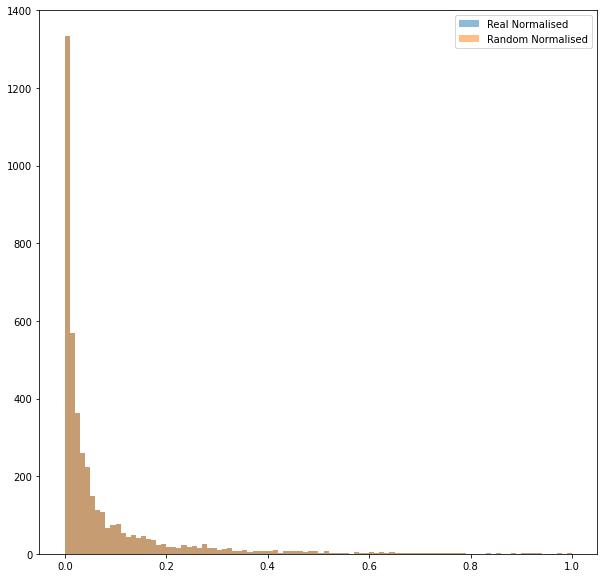

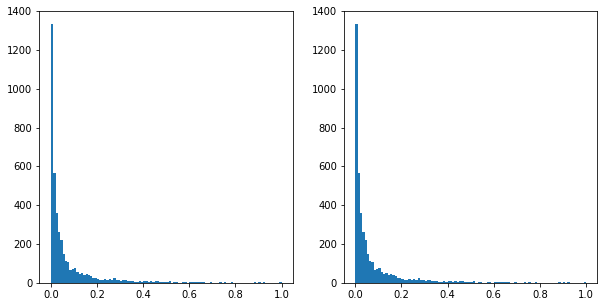

In [ ]:

plt.figure(figsize=(10,10))
plt.hist(match['s_norm'],alpha=0.5,bins=100)
plt.hist(random['s_r_norm'],alpha=0.5,bins=100)
plt.legend(['Real Normalised','Random Normalised'])


plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.hist(match['s_norm'],bins=100)
plt.subplot(1,2,2)
plt.hist(random['s_r_norm'],bins=100)

###Optimising S statistic

Optimise the S statistic to find the 5% thresholf

In [ ]:
#Concatinate Real and Random for vectorisation to Optimise the S statistic threshold value
t1 = random[['s_r','s_r_norm']] #Concatinate for vectorisation and faster calculation
test_random_real = pd.concat([ match,t1 ],axis=1) #concatinate matched dataset with s values for the monte carlo simulation
test_random_real.head(2)

,flux,RA,Dec,F_BLIND_MF_SPIRE_250,FErr_BLIND_MF_SPIRE_250,F_BLIND_MF_SPIRE_350,FErr_BLIND_MF_SPIRE_350,F_BLIND_MF_SPIRE_500,FErr_BLIND_MF_SPIRE_500,r,P,RA_pix,Dec_pix,F_BLIND_pix_SPIRE_250,FErr_BLIND_pix_SPIRE_250,ID_match,Project_match,Time_match,RA_match,RA_ERR_match,DEC_match,DEC_ERR_match,flux_match,flux_err_match,RMS_match,SNR_match,NPIX_match,RES_match,Multi_match,Separation,s,s_norm,s_r,s_r_norm
0,13400.0,150.745831,2.343037,0.359749,0.002514,0.170467,0.002517,0.071225,0.002517,0.815560,1.0,150.745553,2.343315,0.334421,0.002447,14.0,b'COSMOSVLA3',b'J100259.05+022034.9',150.746079,0.010,2.343043,0.010,5940.0,300.0,4.3,1300.0,108.0,1.0,0.0,0.893035,0.000003,0.000034,0.000003,0.000034
1,1190.0,149.773592,2.636177,0.230962,0.002527,0.108277,0.002489,0.040625,0.002555,0.842207,1.0,149.773036,2.636732,0.204455,0.002459,10944.0,b'COSMOSVLA3',b'J095905.52+023809.8',149.773020,9.999,2.636075,9.999,948.0,-99.0,2.5,-99.0,1327.0,1.0,1.0,2.089115,0.000059,0.000769,0.000059,0.000769


s-limit: 0.178, result:0.15528
s-limit: 0.176, result:0.15492
s-limit: 0.174, result:0.15443
s-limit: 0.172, result:0.15387
s-limit: 0.17, result:0.15351
s-limit: 0.168, result:0.15295
s-limit: 0.166, result:0.15225
s-limit: 0.164, result:0.15176
s-limit: 0.162, result:0.1512
s-limit: 0.16, result:0.15078
s-limit: 0.158, result:0.15036
s-limit: 0.156, result:0.15001
s-limit: 0.154, result:0.14945
s-limit: 0.152, result:0.14841
s-limit: 0.15, result:0.14764
s-limit: 0.148, result:0.14695
s-limit: 0.146, result:0.1464
s-limit: 0.144, result:0.14605
s-limit: 0.142, result:0.1455
s-limit: 0.14, result:0.14474
s-limit: 0.138, result:0.14377
s-limit: 0.136, result:0.14301
s-limit: 0.134, result:0.14253
s-limit: 0.132, result:0.14178
s-limit: 0.13, result:0.14137
s-limit: 0.128, result:0.14068
s-limit: 0.126, result:0.14041
s-limit: 0.124, result:0.13979
s-limit: 0.122, result:0.13904
s-limit: 0.12, result:0.13836
s-limit: 0.118, result:0.13775
s-limit: 0.116, result:0.13714
s-limit: 0.114, r

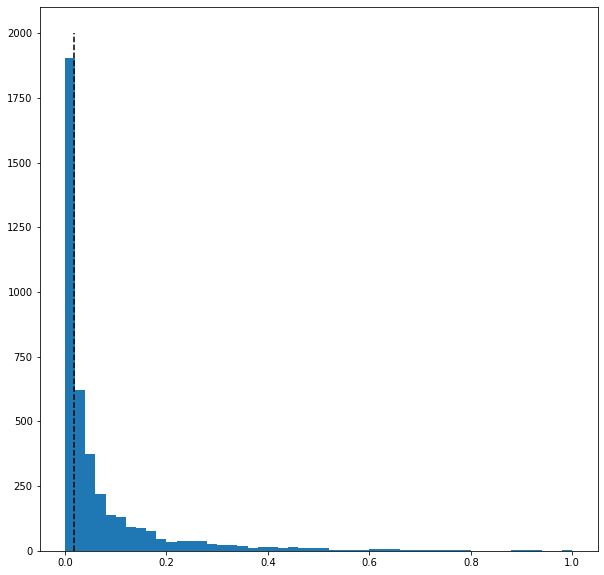

In [ ]:
#For loop version of S threshold optimisation
ratio_s=1
filter1=0.18
while ratio_s>0.05: #purity of 95%
  filter1-=0.002 #stepsize
  number_s=[]
  
  for idx,source in test_random_real.iterrows(): #iterate through real sources
    if source['s_norm']>filter1: #go back to while if source s value is greater than threshold
      continue
    #finds the number of random sources with s less than the s value of our source.
    num_rand = test_random_real['s_r_norm'][ test_random_real['s_r_norm'] < source['s_norm'] ].count() #number of Monte Carlo sources with S values better than real sources
    number_s.append(num_rand)
  avg_s = np.mean(number_s) #avg number of Monte Carlo sources with S values better than Real sources
  ratio_s = avg_s/test_random_real['s_r_norm'].count() #proportion of Monte Carlo sources with S value better than the real sources
  print(f's-limit: {round(filter1,5)}, result:{round(ratio_s,5)}') #we want ratio_s to be less than 0.05 so that 95% of the random sources have a worse S value than the real sources
  

print(round(avg_s/match['s_norm'].count(),5),'\n\n')
print(f'threshold value of s-{round(filter1,5)}')
plt.figure(figsize=(10,10))
plt.hist(random['s_r_norm'],bins=50)
plt.vlines(filter1,ymin=0,ymax=2000,ls='--')

In [ ]:
s5rand = test_random_real.s_r_norm.quantile(0.05) #S value that includes 5% of the random sources
s10rand = test_random_real.s_r_norm.quantile(0.1) #S value that includes 10% of the random sources
#s5rand,s10rand #(0.009698651304308525, 0.01983451951037176)

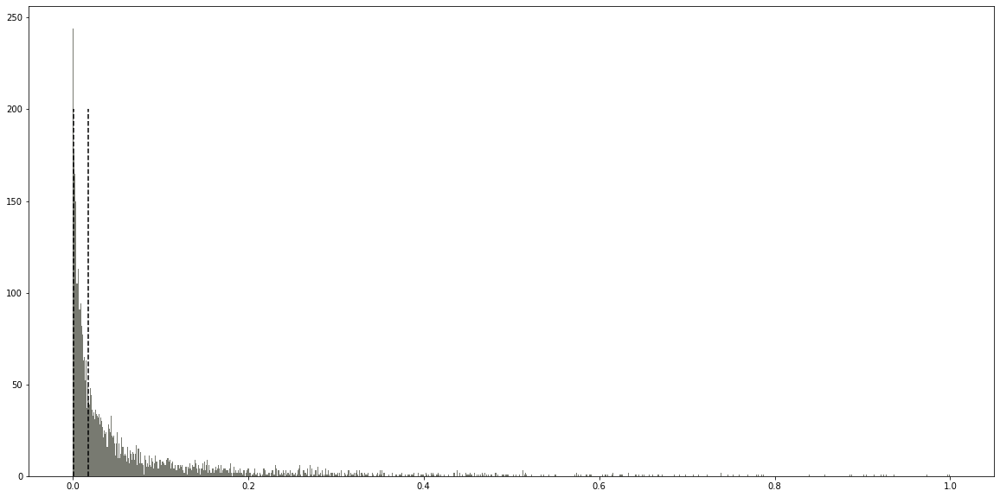

In [ ]:

plt.figure(figsize=(20,10))
plt.hist(test_random_real['s_norm'],bins=1000)
plt.hist(random['s_r_norm'],bins=1000,alpha=0.4)
plt.vlines(filter1,ymin=0,ymax=200,ls='--')
plt.vlines(s5rand,ymin=0,ymax=200,ls='--')
#plt.xlim(0,0.4)

Proportion of data less within the threshold

In [ ]:
s1 = test_random_real[test_random_real['s_norm']< filter1] #Sources with S value less than threshold
s1['s_norm'].count()/test_random_real['s_norm'].count() #Proportion of total sources with value of S less than threshold

0.4450415241817294

In [ ]:
val1 = test_random_real['s_norm'][ test_random_real['s_norm']< filter1 ].count() #number of real sources within threshold
val2 = test_random_real['s_r_norm'][ test_random_real['s_r_norm']< filter1 ].count() #number of random sources within threshold
print(f'There are {round(val1,5)} sources with S less than {round(filter1,5)},\nThere are {round(val2,5)} random sources with S less than {round(filter1,5)}, \nSo there are {round(val1-val2,5)} Real sources less than {round(filter1,5)}, \nSo of sources with S less than {round(filter1,5)}, {round( (val1-val2)/val1,5)} of them are real, \nOr as a percentage {round(100*(val1-val2)/val1,5)}% of the sources with S less than {round(filter1,5)} are Real ')

There are 1822 sources with S less than 0.018,
There are 1822 random sources with S less than 0.018, 
So there are 0 Real sources less than 0.018, 
So of sources with S less than 0.018, 0.0 of them are real, 
Or as a percentage 0.0% of the sources with S less than 0.018 are Real 


In [ ]:
val = test_random_real['s_r'][ test_random_real['s_r'] < test_random_real['s'] ].count() / test_random_real['s'].count()
val #proportion of the Monte Carlo sources with S values better than the real sources for the Total sources

0.0

95.8 \% of the data has a s value less than 0.49 with contamination from random matching



####Calculating the average s statistic

In [ ]:
mean_s_max=[0.23199999999999998, 0.23399999999999999, 0.23399999999999999, 0.235, 0.21699999999999997, 0.247, 0.249, 0.241, 0.249, 0.249, 0.249, 0.249, 0.249, 0.241, 0.249, 0.249, 0.18399999999999994, 0.23199999999999998, 0.243, 0.249, 0.249, 0.249, 0.19199999999999995, 0.244, 0.20999999999999996, 0.249, 0.249, 0.243, 0.241, 0.249, 0.21799999999999997, 0.19999999999999996, 0.23199999999999998, 0.22799999999999998, 0.249, 0.22699999999999998, 0.22799999999999998, 0.23199999999999998, 0.249, 0.249, 0.19999999999999996, 0.249, 0.249, 0.23199999999999998, 0.241, 0.243, 0.249, 0.238, 0.249, 0.245, 0.249, 0.23099999999999998, 0.21899999999999997, 0.249, 0.249, 0.249, 0.23199999999999998, 0.247, 0.245, 0.249, 0.249, 0.22399999999999998, 0.21999999999999997, 0.245, 0.249, 0.249, 0.22399999999999998, 0.249, 0.21799999999999997, 0.249, 0.249, 0.247, 0.21799999999999997, 0.21799999999999997, 0.23199999999999998, 0.249, 0.249, 0.243, 0.22899999999999998, 0.249, 0.249, 0.19899999999999995, 0.243, 0.241, 0.249, 0.249, 0.244, 0.247, 0.249, 0.249, 0.22599999999999998, 0.23399999999999999, 0.249, 0.249, 0.249, 0.249, 0.21699999999999997, 0.21299999999999997, 0.23099999999999998, 0.249]

dat0 = Table.read(f'Random_matches/rand_51', format='fits')
rand = dat0.to_pandas() #convert table to dataframe
rand.drop('col1',axis=1,inplace=True)
rand = rand.rename(columns={"flux": "flux_match"})

#Calcuate S statistic
rand['s_r']= stat( vla_data['flux'], rand['flux_match'], rand['Separation'].values ) #S stat
rand['s_r_norm'] = norm( rand['s_r'])                                     #Normalised S stat
acc_optimise_s( match, rand,0.16678,0.00002)               #Accurate S threshold calculation


s_cutoff = np.median(mean_s_max) #S threshold average of the S cutoff for the 100 Monte Carlo simulations 
s_cutoff = 0.166
val1 = match['s_norm'][match['s_norm']< s_cutoff].count() #number of real sources within threshold
val2 = rand['s_r_norm'][rand['s_r_norm']< s_cutoff].count() #number of random sources within threshold
print(f'There are {round(val1,5)} sources with S less than {round(s_cutoff,5)},\nThere are {round(val2,5)} random sources with S less than {round(s_cutoff,5)}, \nSo there are {round(val1-val2,5)} Real sources less than {round(s_cutoff,5)}, \nSo of sources with S less than {round(s_cutoff,5)}, {round( (val1-val2)/val1,5)} of them are real, \nOr as a percentage {round(100*(val1-val2)/val1,5)}% of the sources with S less than {round(s_cutoff,5)} are Real ')

s-limit: 0.16676, result:0.04322
Final s-limit is: 0.16676, with result:0.04322, this removes 0.01321 of the data 


threshold value of s-0.16676
There are 3588 sources with S less than 0.166,
There are 569 random sources with S less than 0.166, 
So there are 3019 Real sources less than 0.166, 
So of sources with S less than 0.166, 0.84142 of them are real, 
Or as a percentage 84.14158% of the sources with S less than 0.166 are Real 


####S limit for real sources

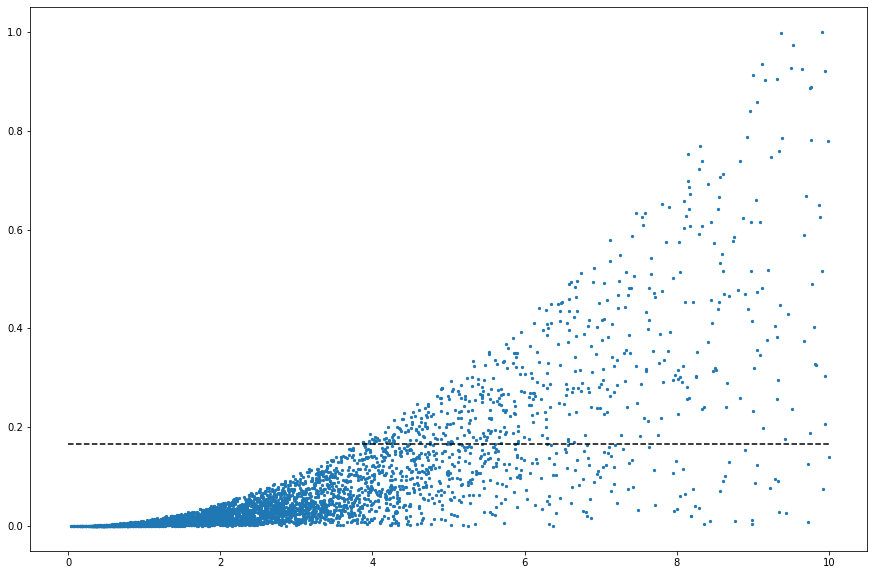

In [ ]:
plt.figure(figsize=(15,10))
plt.scatter(match['Separation'],match['s_norm'],s=5)
plt.hlines(s_cutoff,xmin=0,xmax=10,ls='--')

(array([480., 338., 251., 228., 185., 157., 117., 109., 109.,  84.,  76.,
         84.,  80.,  71.,  62.,  53.,  55.,  62.,  62.,  48.,  36.,  41.,
         31.,  40.,  31.,  25.,  27.,  29.,  26.,  29.,  26.,  33.,  23.,
         15.,  15.,  18.,  16.,  14.,  19.,  21.,  16.,  14.,  17.,  19.,
         14.,  27.,  13.,  16.,  12.,   7.,  14.,  11.,  11.,   6.,   8.,
         11.,  13.,  11.,  18.,   9.,  10.,   7.,  12.,  13.,  15.,   9.,
          7.,   7.,   9.,  10.,   8.,  10.,   7.,  10.,   5.,  11.,   4.,
          8.,   5.,   7.,   6.,   6.,   3.,   7.,   8.,   1.,   4.,   4.,
          3.,   3.,   1.,   8.,   5.,   3.,   2.,   8.,   1.,  11.,   5.,
          4.]),
 array([0.        , 0.00238077, 0.00476153, 0.0071423 , 0.00952306,
        0.01190383, 0.01428459, 0.01666536, 0.01904612, 0.02142689,
        0.02380765, 0.02618842, 0.02856918, 0.03094995, 0.03333071,
        0.03571148, 0.03809224, 0.04047301, 0.04285377, 0.04523454,
        0.04761531, 0.04999607, 0.05237684, 0.

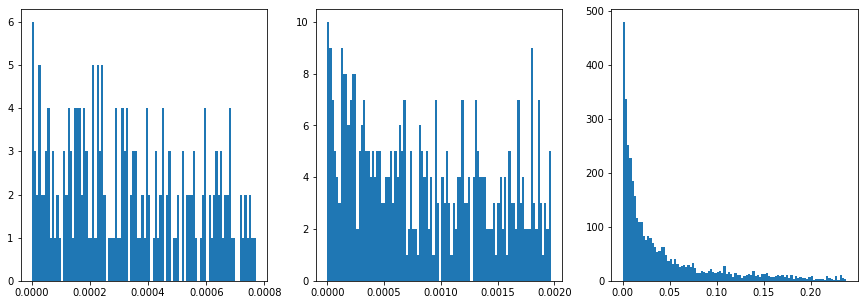

In [ ]:
dat5 = Table.read(f'Random_matches/Real_Radio_Submm_sources_5_percent_cutoff.csv', format='csv')
real_5_cutoff = dat5.to_pandas() #convert table to dataframe

dat6 = Table.read(f'Random_matches/Real_Radio_Submm_sources_10_percent_cutoff.csv', format='csv')
real_10_cutoff = dat6.to_pandas() #convert table to dataframe

dat5 = Table.read(f'Random_matches/Real_Radio_Submm_sources_s_statistic.csv', format='csv')
real_purity_cutoff = dat5.to_pandas() #convert table to dataframe
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.hist(real_5_cutoff['s_norm'],bins=100)
plt.subplot(1,3,2)
plt.hist(real_10_cutoff['s_norm'],bins=100)
plt.subplot(1,3,3)
plt.hist(real_purity_cutoff['s_norm'],bins=100)

(array([ 12.,  18.,  30.,  46.,  54.,  56.,  67.,  69.,  77.,  92., 102.,
        115., 114., 112., 127., 121.,  99., 101., 122., 107., 105.,  91.,
         87.,  94.,  88.,  87.,  96.,  96.,  81.,  70.,  78.,  67.,  71.,
         73.,  64.,  49.,  52.,  44.,  44.,  53.,  36.,  42.,  49.,  34.,
         41.,  35.,  35.,  28.,  19.,  21.,  20.,  22.,  22.,  10.,  17.,
         18.,  14.,  13.,  13.,   9.,   7.,   4.,   9.,  10.,   2.,   8.,
          5.,   6.,   7.,   4.,   6.,   6.,   3.,   2.,   3.,   2.,   3.,
          3.,   0.,   3.,   4.,   3.,   3.,   2.,   1.,   2.,   2.,   1.,
          1.,   2.,   3.,   1.,   2.,   2.,   2.,   1.,   0.,   3.,   0.,
          3.]),
 array([0.04136804, 0.14090549, 0.24044295, 0.3399804 , 0.43951785,
        0.53905531, 0.63859276, 0.73813022, 0.83766767, 0.93720513,
        1.03674258, 1.13628003, 1.23581749, 1.33535494, 1.4348924 ,
        1.53442985, 1.63396731, 1.73350476, 1.83304221, 1.93257967,
        2.03211712, 2.13165458, 2.23119203, 2.

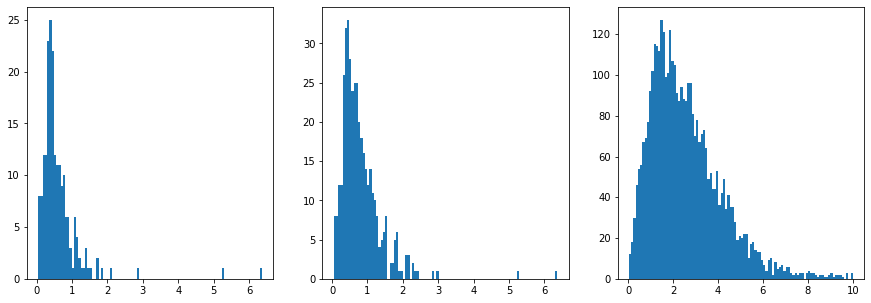

In [ ]:
dat5 = Table.read(f'Random_matches/Real_Radio_Submm_sources_5_percent_cutoff.csv', format='csv')
real_5_cutoff = dat5.to_pandas() #convert table to dataframe

dat6 = Table.read(f'Random_matches/Real_Radio_Submm_sources_10_percent_cutoff.csv', format='csv')
real_10_cutoff = dat6.to_pandas() #convert table to dataframe

dat5 = Table.read(f'Random_matches/Real_Radio_Submm_sources_s_statistic.csv', format='csv')
real_purity_cutoff = dat5.to_pandas() #convert table to dataframe
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.hist(real_5_cutoff['Separation'],bins=100)
plt.subplot(1,3,2)
plt.hist(real_10_cutoff['Separation'],bins=100)
plt.subplot(1,3,3)
plt.hist(real_purity_cutoff['Separation'],bins=100)

####Counterpart statistics

In [ ]:
display(real_purity_cutoff.head())
print((len(real_purity_cutoff[real_purity_cutoff['Multi_match']>0])/len(real_purity_cutoff))*100)

,col0,Herschel_RA,Herschel_Dec,F_BLIND_MF_SPIRE_250,FErr_BLIND_MF_SPIRE_250,F_BLIND_MF_SPIRE_350,FErr_BLIND_MF_SPIRE_350,F_BLIND_MF_SPIRE_500,FErr_BLIND_MF_SPIRE_500,r,P,RA_pix,Dec_pix,F_BLIND_pix_SPIRE_250,FErr_BLIND_pix_SPIRE_250,ID_match,Project_match,Time_match,RA,RA_ERR_match,DEC,DEC_ERR_match,flux_match,flux_err_match,RMS_match,SNR_match,NPIX_match,RES_match,Multi_match,Separation,s,s_norm
0,4065,150.002789,1.677356,0.011741,0.002466,0.013827,0.002556,0.006114,0.002451,0.593531,0.855526,150.003345,1.678467,0.013600,0.002429,10607.0,b'COSMOSVLA3',b'J100000.53+014039.9',150.002216,0.11,1.677761,0.11,11.1,2.3,2.20,5.02,14.0,0.0,0.0,2.524890,0.005823,0.075769
1,2976,149.726668,2.383121,0.018214,0.002520,0.020242,0.002527,0.012628,0.002581,0.861825,0.950453,149.726390,2.383398,0.017326,0.002453,10580.0,b'COSMOSVLA3',b'J095854.20+022255.9',149.725839,0.11,2.382218,0.11,11.2,2.3,2.22,5.02,15.0,0.0,0.0,4.410614,0.017664,0.229836
2,2126,150.313011,2.473995,0.022987,0.002532,0.014443,0.002521,0.007279,0.002515,0.639236,0.973956,150.313567,2.473439,0.021102,0.002463,10658.0,b'COSMOSVLA3',b'J100115.20+022830.1',150.313364,0.11,2.475038,0.11,11.2,2.3,2.24,5.01,16.0,0.0,0.0,3.964257,0.014294,0.185988
3,2489,150.504564,2.445899,0.020486,0.002499,0.025682,0.002546,0.020751,0.002511,0.898308,0.966388,150.503730,2.446732,0.019463,0.002433,10699.0,b'COSMOSVLA3',b'J100201.11+022642.5',150.504639,0.11,2.445152,0.11,11.3,2.3,2.22,5.10,13.0,0.0,0.0,2.701621,0.006619,0.086126
4,112,150.149252,2.594283,0.078074,0.002529,0.075655,0.002538,0.044885,0.002512,0.910865,1.000000,150.148418,2.593449,0.062661,0.002423,10621.0,b'COSMOSVLA3',b'J100035.73+023535.3',150.148903,0.11,2.593144,0.11,11.5,2.4,2.28,5.06,14.0,0.0,0.0,4.286592,0.016455,0.214105


0.37234042553191493


In [ ]:
print(len(real_purity_cutoff))
print(len(real_5_cutoff))
print(len(real_10_cutoff))
print('Percentage of Herschel sources with true radio counterparts 95% purity-',round((len(real_purity_cutoff)/len(h_subset))*100,4),'%')
print('Percentage of Herschel sources with true radio counterparts 5% cutoff-',round((len(real_5_cutoff)/len(h_subset))*100,4),'%')
print('Percentage of Herschel sources with true radio counterparts 10% cutoff-',round((len(real_10_cutoff)/len(h_subset))*100,4),'%\n\n')

print('Percent of matches with true counterparts from initial matching 95% purity-',round((len(real_purity_cutoff)/len(match_df))*100,4),'%')
print('Percent of matches with true counterparts from initial matching 5% cutoff-',round((len(real_5_cutoff)/len(match_df))*100,4),'%')
print('Percent of matches with true counterparts from initial matching 10% cutoff-',round((len(real_10_cutoff)/len(match_df))*100,4),'%')



3760
205
410
Percentage of Herschel sources with true radio counterparts 95% purity- 48.5412 %
Percentage of Herschel sources with true radio counterparts 5% cutoff- 2.6465 %
Percentage of Herschel sources with true radio counterparts 10% cutoff- 5.2931 %


Percent of matches with true counterparts from initial matching 95% purity- 81.5088 %
Percent of matches with true counterparts from initial matching 5% cutoff- 4.444 %
Percent of matches with true counterparts from initial matching 10% cutoff- 8.8879 %


##Optical Counterparts

load in dataset

In [ ]:
#Read in the full counterparts dataset
optical_pure = Table.read(f'Optical counterparts/Optical_Herschel_Radio_s_statistic_purity.fits', format='fits').to_pandas()
optical_5= Table.read(f'Optical counterparts/Optical_Herschel_Radio_5_percent.fits', format='fits').to_pandas()
optical_10= Table.read(f'Optical counterparts/Optical_Herschel_Radio_10_percent.fits', format='fits').to_pandas()
#creates a new column where if a column has a nan for separation it is labelled 0, otherwise 1
optical_pure['Counterpart']=np.where(np.any(np.isnan(optical_pure[['Separation']]),axis=1), 0, 1) 
optical_5['Counterpart']=np.where(np.any(np.isnan(optical_5[['Separation']]),axis=1), 0, 1) 
#display(optical_pure.head())
#display(optical_pure[optical_pure['Counterpart']==0])

In [ ]:
print(f'sources in optical_pure-{len(optical_pure)}')
print(f'sources in optical_5-{len(optical_5)}')
print(f'sources in optical_10-{len(optical_10)}')
print(optical_pure['type'].value_counts())
print('Percentage of Herschel sources with true optical counterparts 95% purity-',round((len(optical_pure['Id'].unique())/len(h_subset))*100,4),'%')
print('Percentage of Herschel sources with true optical counterparts 5% cutoff-',round((len(optical_5['Id'].unique())/len(h_subset))*100,4),'%')
print('Percentage of Herschel sources with true optical counterparts 10% cutoff-',round((len(optical_10['Id'].unique())/len(h_subset))*100,4),'%\n\n')


print('Percent of optical matches with counterparts from 10arcsec radio matching 95% purity-',round((len(optical_pure)/len(match_df))*100,4),'%')
print('Percent of optical matches with counterparts from 10arcsecradio matching 5% cutoff-',round((len(optical_5)/len(match_df))*100,4),'%')
print('Percent of optical matches with counterparts from 10arcsecradio matching 10% cutoff-',round((len(optical_10)/len(match_df))*100,4),'%\n\n')


print('Percent of matches with counterparts from radio matching 95% purity-',round((len(optical_pure['Id'].unique())/len(real_purity_cutoff))*100,4),'%')
print('Percent of matches with counterparts from radio matching 5% cutoff-',round((len(optical_5[optical_5['Separation']>0]['Id'].unique())/len(real_5_cutoff))*100,4),'%')
print('Percent of matches with counterparts from radio matching 10% cutoff-',round((len(optical_10[optical_10['Separation']>0]['Id'].unique())/len(real_10_cutoff))*100,4),'%')

sources in optical_pure-3695
sources in optical_5-1244
sources in optical_10-1838
 0.0    2904
 2.0     366
 1.0     100
-9.0       3
Name: type, dtype: int64
Percentage of Herschel sources with true optical counterparts 95% purity- 43.3901 %
Percentage of Herschel sources with true optical counterparts 5% cutoff- 2.7885 %
Percentage of Herschel sources with true optical counterparts 10% cutoff- 3.9762 %




NameError: ignored

In [ ]:
print('purity')
for i in optical_pure['type'].unique():
  print('type:',i,optical_pure['type'][optical_pure['type']==i].count(),'  ',round(optical_pure['type'][optical_pure['type']==i].count()/len(optical_pure),4),'%')

print('5%')
for i in optical_5['type'].unique():
  print('type:',i,optical_5['type'][optical_5['type']==i].count(),'  ',round(optical_5['type'][optical_5['type']==i].count()/len(optical_5),4),'%')

print('10%')
for i in optical_10['type'].unique():
  print('type:',i,optical_10['type'][optical_10['type']==i].count(),'  ',round(optical_10['type'][optical_10['type']==i].count()/len(optical_10),4),'%')


purity
type: 0.0 2904    0.7859 %
type: 1.0 100    0.0271 %
type: 2.0 366    0.0991 %
type: -9.0 3    0.0008 %
type: nan 0    0.0 %
5%
type: nan 0    0.0 %
type: 0.0 192    0.1543 %
type: 2.0 14    0.0113 %
type: 1.0 10    0.008 %
10%
type: nan 0    0.0 %
type: 0.0 276    0.1502 %
type: 1.0 14    0.0076 %
type: 2.0 22    0.012 %


###Data Exploration

####Age of galaxies

Text(0.5, 1.0, 'Observed')

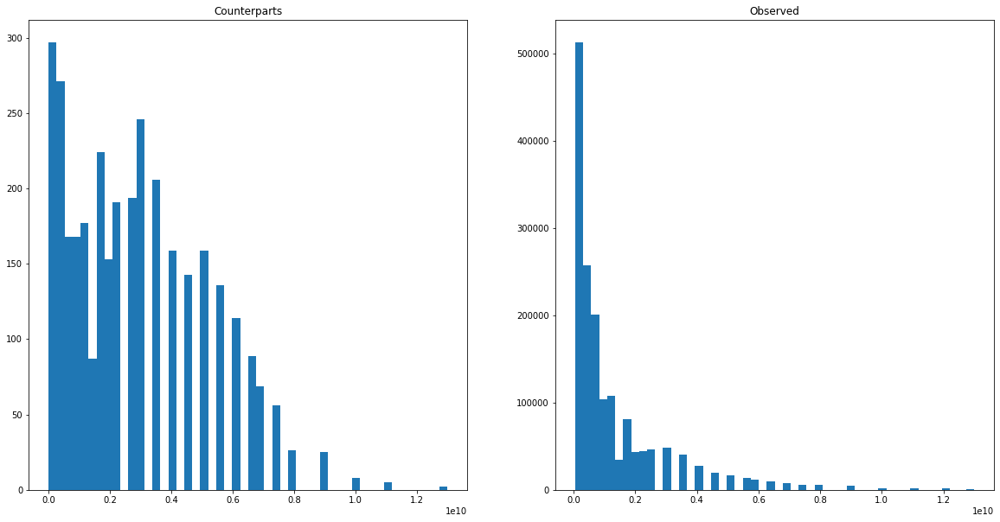

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.hist(optical_pure['age'],bins=50)
plt.title('Counterparts')
plt.subplot(1,2,2)
ag=optical_data[optical_data['type']==0]
plt.hist(ag[ag['age']>0]['age'],bins=50)
plt.title('Observed')

####SFR

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
test=optical_pure[optical_pure['SFR_best']>-90]
plt.xlim(-10,10)
plt.hist(test['SFR_best'],bins=100)
plt.subplot(1,2,2)
plt.hist(t['SFR_best'],bins=100)
plt.xlim(-10,10)

NameError: ignored

####Mass

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
test=optical_pure[optical_pure['mass_best']>0]
plt.hist(test['mass_best'],bins=100)
plt.xlim(2.5,15)
plt.subplot(1,2,2)
plt.hist(t,bins=100)
plt.xlim(2.5,15)
print(test['mass_best'].mean())
print(np.mean(t))

####Redshift

(0.0, 11.0)

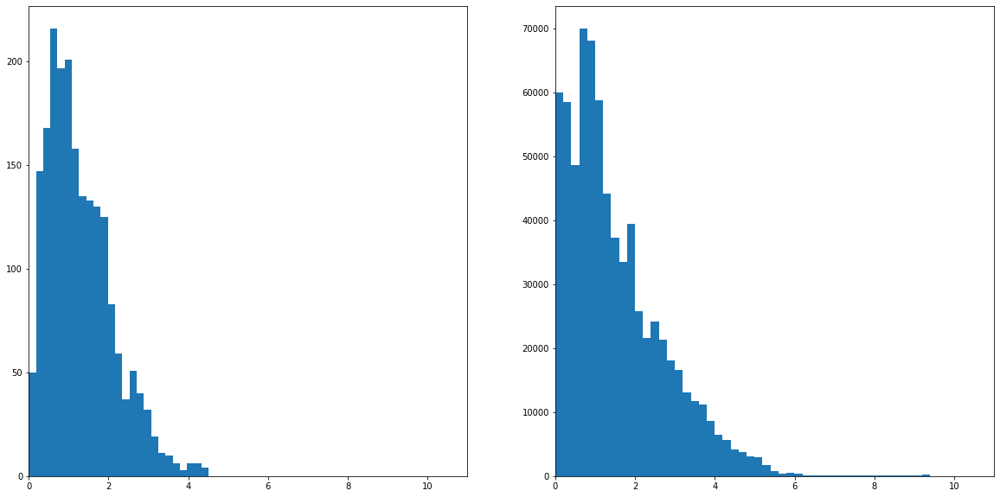

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
test=optical_pure[optical_pure['zBEST']>-10]
test=test[test['zBEST']<99]
plt.hist(test['zBEST'],bins=25)
plt.xlim(0,11)
plt.subplot(1,2,2)
plt.hist(optical_data[optical_data['zBEST']>-10]['zBEST'],bins=500)
plt.xlim(0,11)

####Mass against redshift

(6.0, 12.5)

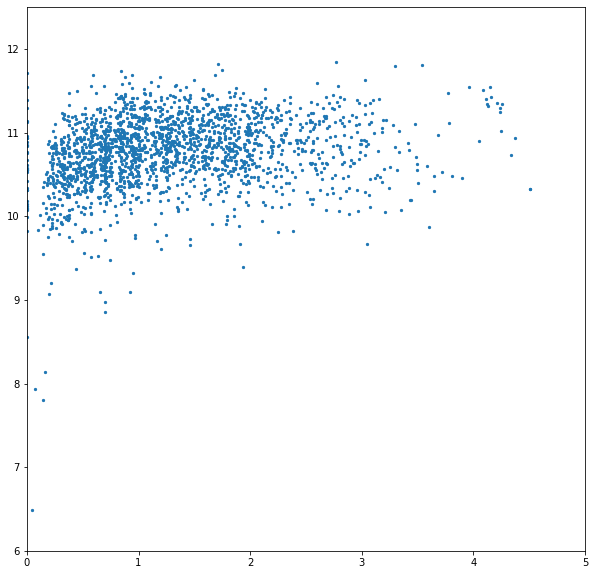

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(optical_pure['zBEST'],optical_pure['mass_best'],s=5)
plt.xlim(0,5)
plt.ylim(6,12.5)

####SFR against redshift

(-4.0, 4.0)

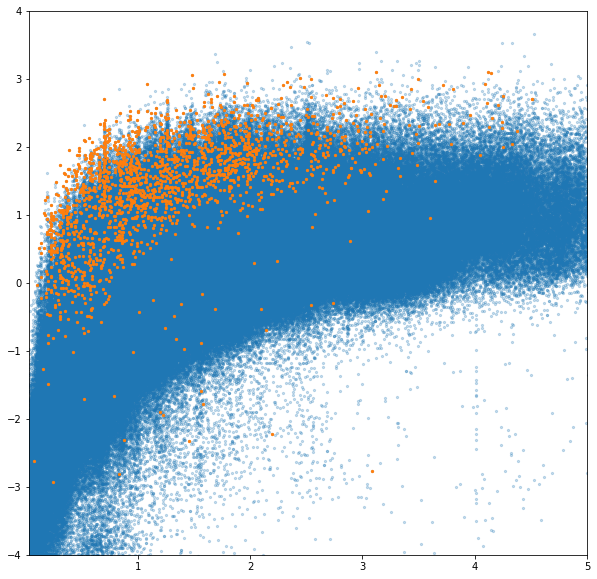

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(optical_data['zBEST'],optical_data['SFR_best'],s=5,alpha=0.25)
plt.scatter(optical_pure['zBEST'],optical_pure['SFR_best'],s=5)
plt.xlim(0.03,5)
plt.ylim(-4,4)


(0.0, 15.0)

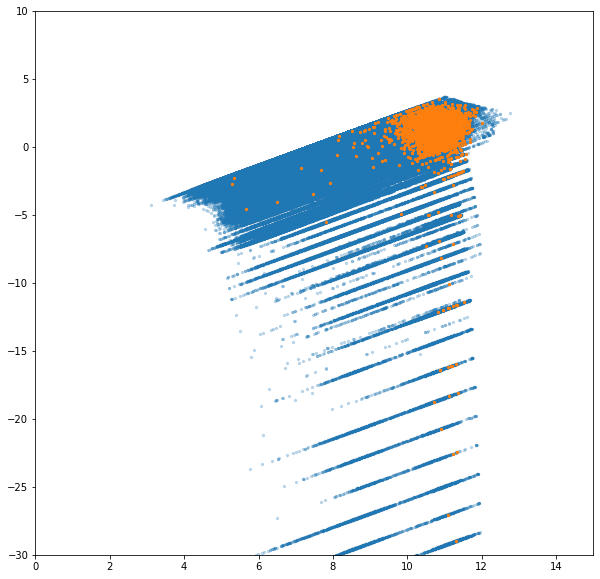

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x=optical_data['mass_best'],y=optical_data['SFR_best'],s=5,alpha=0.25)
plt.scatter(x=optical_pure['mass_best'],y=optical_pure['SFR_best'],s=5)
plt.ylim(-30,10)
plt.xlim(0,15)

NameError: ignored

####Distribution of intensity of flux bands

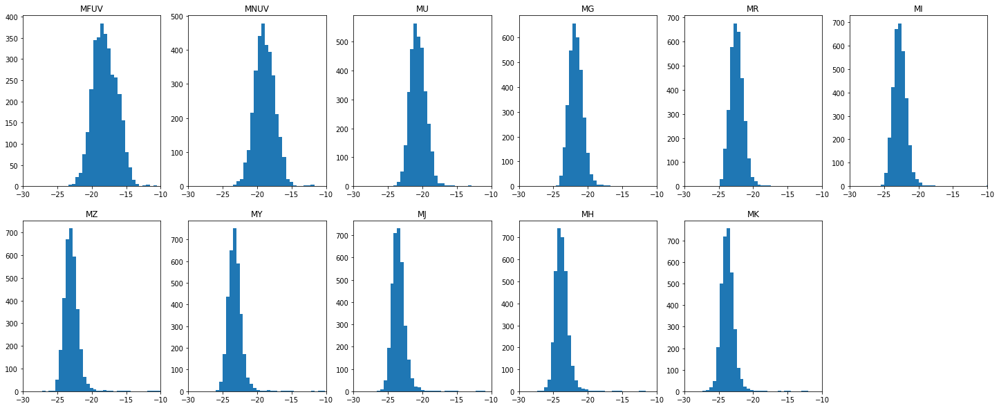

In [ ]:
bands=['MFUV',	'MNUV',	'MU',	'MG',	'MR',	'MI',	'MZ',	'MY',	'MJ',	'MH','MK']
i=1
plt.figure(figsize=(25,10))
for band in bands:
  
  plt.subplot(2,6,i)
  plt.hist(optical_pure[band],bins=2000)
  plt.xlim(-30,-10)
  plt.title(band)
  i+=1

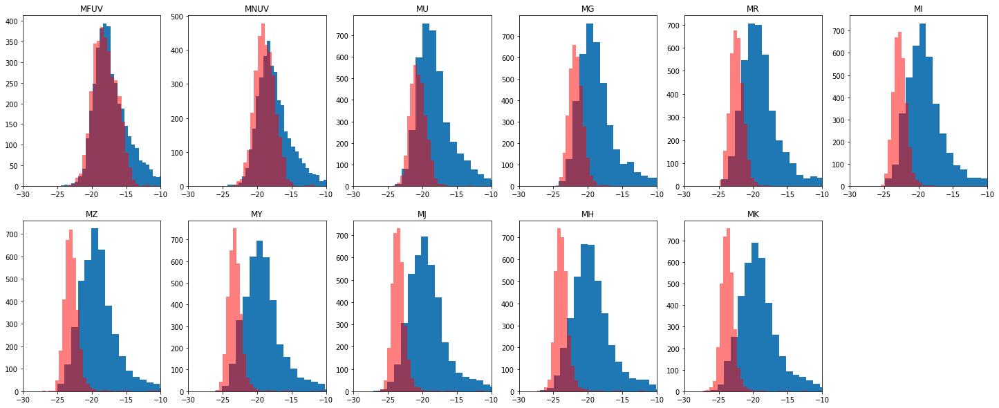

In [ ]:
bands=['MFUV',	'MNUV',	'MU',	'MG',	'MR',	'MI',	'MZ',	'MY',	'MJ',	'MH','MK']
i=1
plt.figure(figsize=(25,10))
for band in bands:
  
  plt.subplot(2,6,i)
  plt.hist(optical_data[band].sample(4000),bins=2000)
  plt.hist(optical_pure[band],bins=2000,alpha=0.5,color='r')
  plt.xlim(-30,-10)
  plt.title(band)
  i+=1

###Descriptive Analysis

In [ ]:
optical_pure = optical_pure.rename(columns={'F_BLIND_MF_SPIRE_250': 'H_250_flux','F_BLIND_MF_SPIRE_350': 'H_350_flux','F_BLIND_MF_SPIRE_500': 'H_500_flux','flux_match':'Radio_flux'})

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fed0fcfa6d0>,
      dtype=object)

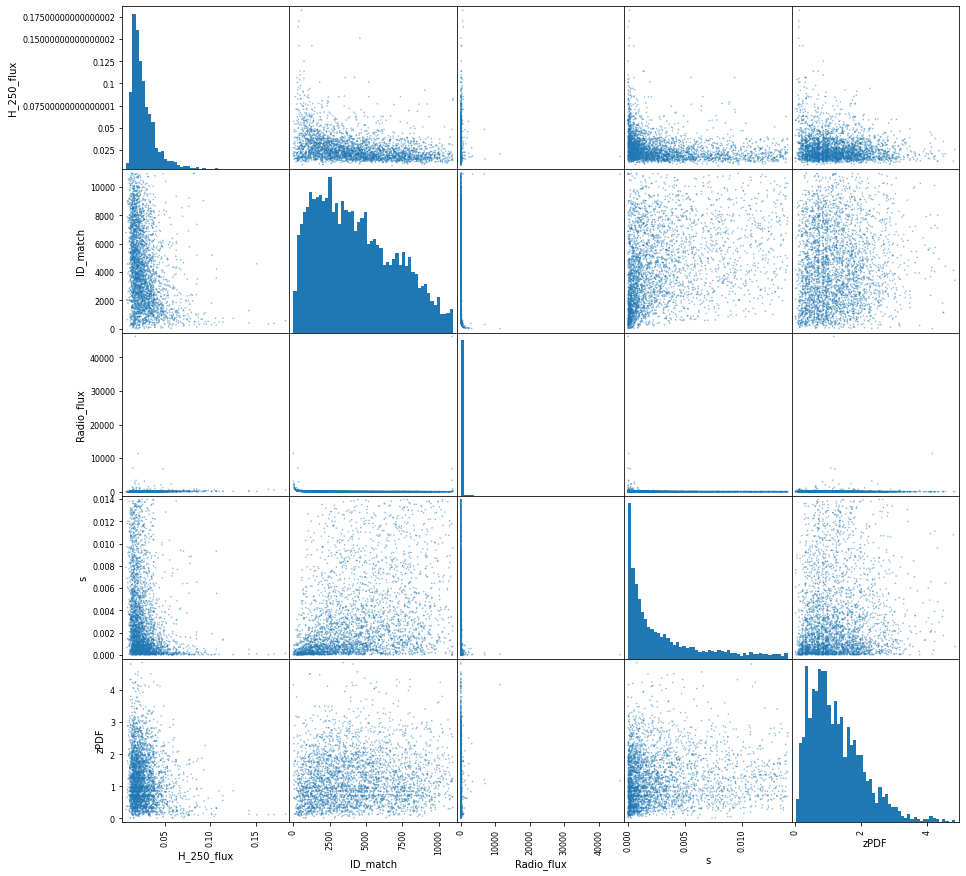

In [ ]:
optical_pure2=optical_pure[optical_pure['zPDF']>0]
scatter_matrix(optical_pure2[['H_250_flux','ID_match','Radio_flux','s','zPDF']],figsize=(15, 15),hist_kwds={'bins':50},s=10)

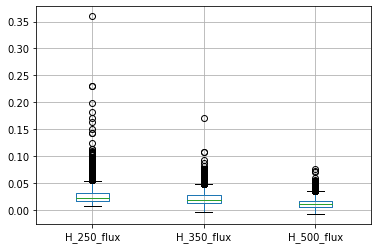

In [ ]:
optical_pure[['H_250_flux','H_350_flux','H_500_flux']].boxplot()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fed0ac39950>,
      dtype=object)

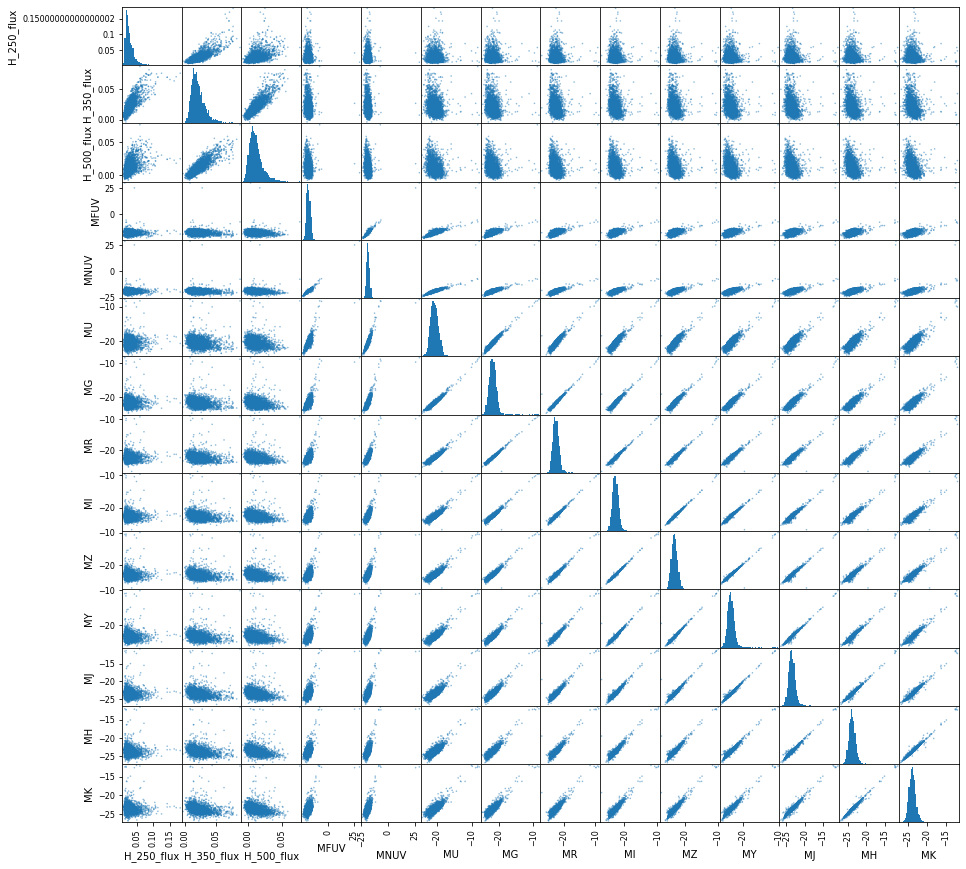

In [ ]:
'MFUV',	'MNUV',	'MU',	'MG',	'MR',	'MI',	'MZ',	'MY',	'MJ',	'MH'
scatter_matrix(optical_pure2[['H_250_flux','H_350_flux','H_500_flux','MFUV',	'MNUV',	'MU',	'MG',	'MR',	'MI',	'MZ',	'MY',	'MJ',	'MH',	'MK']],figsize=(15, 15),hist_kwds={'bins':50},s=10)

####Histogram of all the features

89


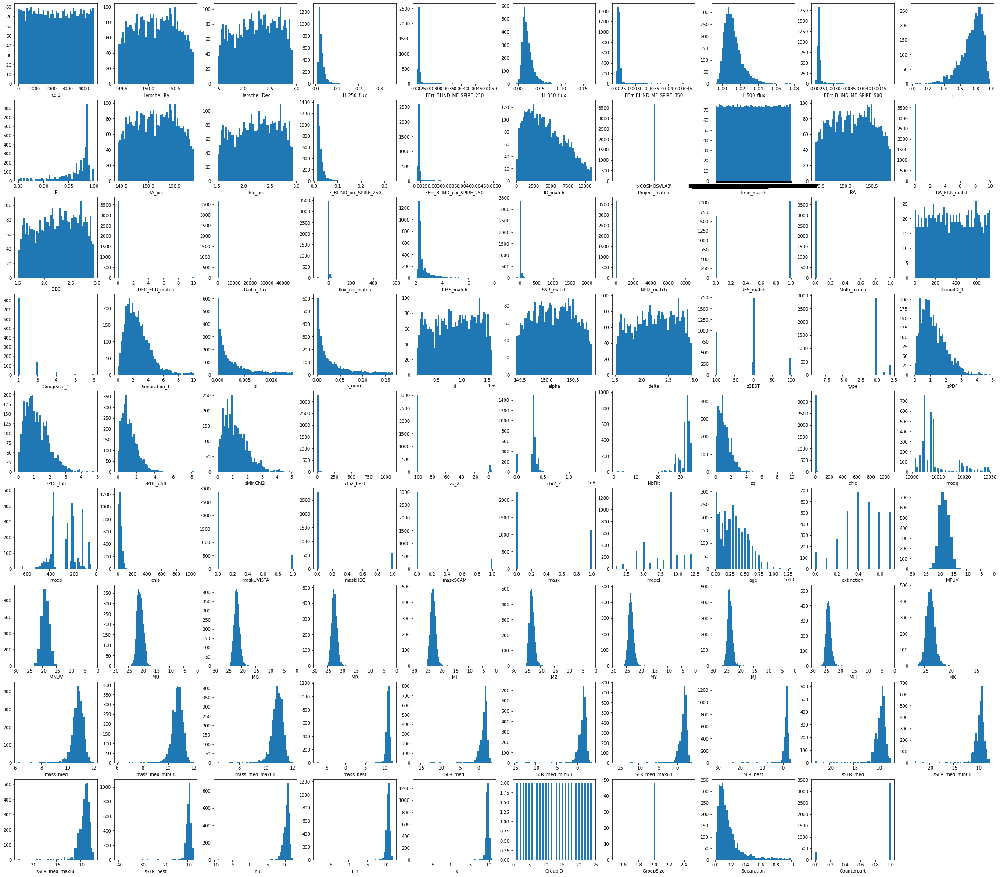

In [ ]:
plt.figure(figsize=(40,40))
i=1
print(len(optical_pure.columns))
for col in optical_pure.columns:
  plt.subplot(10,10,i)
  try:
    optical_pure2=optical_pure[optical_pure[col]>-999]
    plt.hist(optical_pure2[col],bins=50)
    if col in bands:
      plt.xlim(-30,0)
  except:
      
    plt.hist(optical_pure[col],bins=50)
  plt.xlabel(col)
  i+=1

Separation seems to be cut off too low, possibly missing out real counterparts

####Correlation between Features

In [ ]:
correlation  = optical_pure[['H_250_flux','H_350_flux','H_500_flux','RA','DEC','Radio_flux','s_norm','zPDF','age','extinction','MFUV','MNUV','MU','MG','MR','MI','MZ','MY','MJ','MH','MK']]
corr_matrix = correlation.corr() #Correlation Matrix
display(corr_matrix)


,H_250_flux,H_350_flux,H_500_flux,RA,DEC,Radio_flux,s_norm,zPDF,age,extinction,MFUV,MNUV,MU,MG,MR,MI,MZ,MY,MJ,MH,MK
H_250_flux,1.000000,0.789933,0.473050,0.019388,0.021174,0.062172,-0.198782,-0.096311,0.104840,-0.095456,-0.095737,-0.095568,-0.095377,-0.095521,-0.095591,-0.095713,-0.095751,-0.095772,-0.095800,-0.095849,-0.095881
H_350_flux,0.789933,1.000000,0.847887,0.011257,0.036467,0.032932,-0.084360,-0.055079,-0.058787,-0.056321,-0.058165,-0.058369,-0.058264,-0.058158,-0.058212,-0.058205,-0.058230,-0.058245,-0.058304,-0.058425,-0.058490
H_500_flux,0.473050,0.847887,1.000000,0.009330,0.030740,0.010423,0.004229,-0.028463,-0.140952,-0.030854,-0.033092,-0.033495,-0.033360,-0.033102,-0.033100,-0.033003,-0.033002,-0.033009,-0.033086,-0.033226,-0.033267
RA,0.019388,0.011257,0.009330,1.000000,0.035387,-0.024656,0.016270,-0.039416,0.009100,-0.039356,-0.038970,-0.039044,-0.039074,-0.039126,-0.039111,-0.039124,-0.039112,-0.039136,-0.039151,-0.039125,-0.039151
DEC,0.021174,0.036467,0.030740,0.035387,1.000000,0.015445,0.000979,-0.016938,0.011510,-0.017002,-0.017130,-0.017162,-0.017116,-0.017143,-0.017129,-0.017184,-0.017172,-0.017158,-0.017150,-0.017135,-0.017097
Radio_flux,0.062172,0.032932,0.010423,-0.024656,0.015445,1.000000,-0.053741,-0.018782,-0.023441,-0.018802,-0.019100,-0.019062,-0.019009,-0.018962,-0.018953,-0.018892,-0.018874,-0.018860,-0.018832,-0.018832,-0.018808
s_norm,-0.198782,-0.084360,0.004229,0.016270,0.000979,-0.053741,1.000000,0.007923,-0.036379,0.007476,0.007962,0.007770,0.007613,0.007681,0.007709,0.007763,0.007782,0.007826,0.007837,0.007939,0.007955
zPDF,-0.096311,-0.055079,-0.028463,-0.039416,-0.016938,-0.018782,0.007923,1.000000,0.161514,0.999981,0.999805,0.999830,0.999894,0.999908,0.999910,0.999914,0.999915,0.999915,0.999916,0.999916,0.999916
age,0.104840,-0.058787,-0.140952,0.009100,0.011510,-0.023441,-0.036379,0.161514,1.000000,0.163839,0.171637,0.171292,0.169041,0.167462,0.167094,0.166355,0.166237,0.166151,0.166148,0.166223,0.166301
extinction,-0.095456,-0.056321,-0.030854,-0.039356,-0.017002,-0.018802,0.007476,0.999981,0.163839,1.000000,0.999861,0.999888,0.999947,0.999955,0.999956,0.999958,0.999958,0.999958,0.999958,0.999958,0.999958


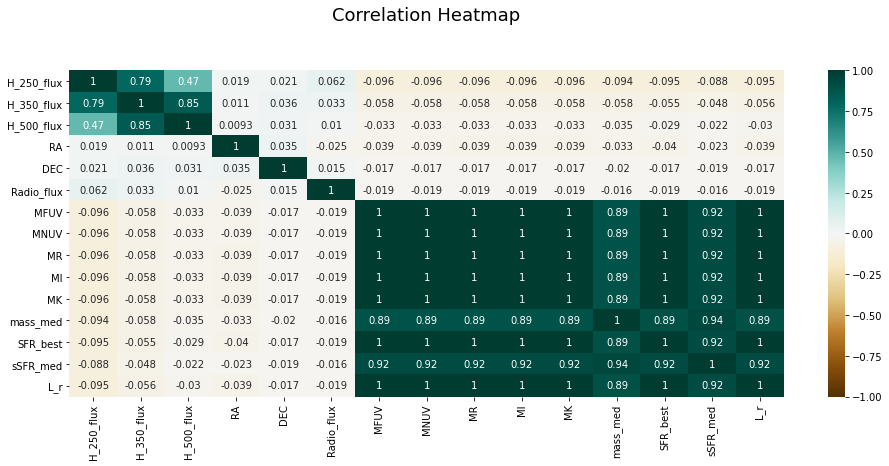

In [ ]:
df_corr = optical_pure[['H_250_flux','H_350_flux','H_500_flux','RA','DEC','Radio_flux','MFUV','MNUV','MR','MI','MK','mass_med','SFR_best','sSFR_med','L_r']]

# code adapted from https://medium.com/@szabo.bibor/how-to-create-a-seaborn-correlation-heatmap-in-python-834c0686b88e
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df_corr.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=50);
#plt.savefig('heatmap.png', dpi=300, bbox_inches='tight')

#Machine Learning Counterparts

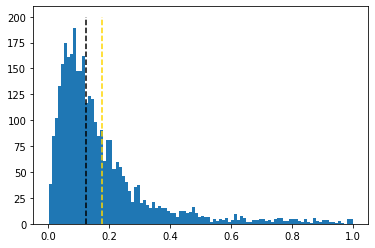

In [ ]:
plt.hist(optical_pure['Separation'],bins=100)
plt.vlines(optical_pure['Separation'].median(),ymin=0,ymax=200,ls='--')
plt.vlines(optical_pure['Separation'].mean(),ymin=0,ymax=200,ls='--',color='gold')